<a href="https://colab.research.google.com/github/leekinyip23/SEGPGroup9a-FrontEnd/blob/master/image_correspondence.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
!ls "/content/drive/My Drive/" # only if you are using Google Drive

 7247.png   7737.png   8219.png   8701.png
 7248.png   7738.png   8220.png   8702.png
 7249.png   7739.png   8221.png   8703.png
 7250.png   7740.png   8222.png   8704.png
 7251.png   7741.png   8223.png   8705.png
 7252.png   7742.png   8224.png   8706.png
 7253.png   7743.png   8225.png   8707.png
 7254.png   7744.png   8226.png   8708.png
 7255.png   7745.png   8227.png   8709.png
 7256.png   7746.png   8228.png   8710.png
 7257.png   7747.png   8229.png   8711.png
 7258.png   7748.png   8230.png   8712.png
 7259.png   7749.png   8231.png   8713.png
 7260.png   7750.png   8232.png   8714.png
 7262.png   7751.png   8233.png   8715.png
 7263.png   7752.png   8234.png   8716.png
 7264.png   7753.png   8235.png   8717.png
 7265.png   7754.png   8236.png   8718.png
 7266.png   7755.png   8237.png   8719.png
 7267.png   7756.png   8238.png   8720.png
 7268.png   7757.png   8239.png   8721.png
 7269.png   7758.png   8240.png   8722.png
 7270.png   7759.png   8241.png   8723.png
 7271.png  

In [ ]:
# replace this with your local directory
%cd '/content/drive/My Drive/COMP3029/2021-2022/Multiview_jpg/Good seeds'
!ls

/content/drive/My Drive/COMP3029/2021-2022/Multiview_jpg/Good seeds
front_S10.jpg  left_S10.jpg  rear_S10.jpg  right_S10.jpg  top_S10.jpg
front_S1.jpg   left_S1.jpg   rear_S1.jpg   right_S1.jpg   top_S1.jpg
front_S2.jpg   left_S2.jpg   rear_S2.jpg   right_S2.jpg   top_S2.jpg
front_S3.jpg   left_S3.jpg   rear_S3.jpg   right_S3.jpg   top_S3.jpg
front_S4.jpg   left_S4.jpg   rear_S4.jpg   right_S4.jpg   top_S4.jpg
front_S5.jpg   left_S5.jpg   rear_S5.jpg   right_S5.jpg   top_S5.jpg
front_S6.jpg   left_S6.jpg   rear_S6.jpg   right_S6.jpg   top_S6.jpg
front_S7.jpg   left_S7.jpg   rear_S7.jpg   right_S7.jpg   top_S7.jpg
front_S8.jpg   left_S8.jpg   rear_S8.jpg   right_S8.jpg   top_S8.jpg
front_S9.jpg   left_S9.jpg   rear_S9.jpg   right_S9.jpg   top_S9.jpg


In [ ]:
!pip install opencv-contrib-python==4.4.0.44

In [ ]:
# Import libraries
import numpy as np
import cv2  
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [ ]:
# Feature Extraction
def extract_sift(img1,img2):

    # Initiate SIFT detector
    sift = cv2.SIFT_create()

    # find the keypoints and descriptors with SIFT
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    # FLANN parameters
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks=50)   # or pass empty dictionary
    flann = cv2.FlannBasedMatcher(index_params,search_params)
    matches = flann.knnMatch(des1,des2,k=2)

    # Need to draw only good matches, so create a mask
    matchesMask = [[0,0] for i in range(len(matches))]

    # ratio test as per Lowe's paper
    good = []

    # Initialize lists
    list_kp1 = []
    list_kp2 = []
    
    # Store all the good matches as per Lowe's ratio test.
    for i,(m,n) in enumerate(matches):
        if m.distance < 0.7*n.distance:
            matchesMask[i]=[1,0]
            good.append(m)

            # x - columns
            # y - rows
            # Get the coordinates
            (x1, y1) = kp1[m.queryIdx].pt
            (x2, y2) = kp2[m.trainIdx].pt

            # Append to each list
            list_kp1.append((x1, y1))
            list_kp2.append((x2, y2))

    draw_params = dict( matchesMask = matchesMask,flags = cv2.DrawMatchesFlags_DEFAULT)
    img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,matches,None,**draw_params)
    img3 = cv2.resize(img3,(800,300))
    cv2_imshow(img3)
    
    print("Total number of matches points: ")
    print(len(good))
    print("Coordinates of each matches points in Image 1: ")
    print(list_kp1)
    print("Coordinates of each matches points in Image 2: ")
    print(list_kp2)


___________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and left_S1 view


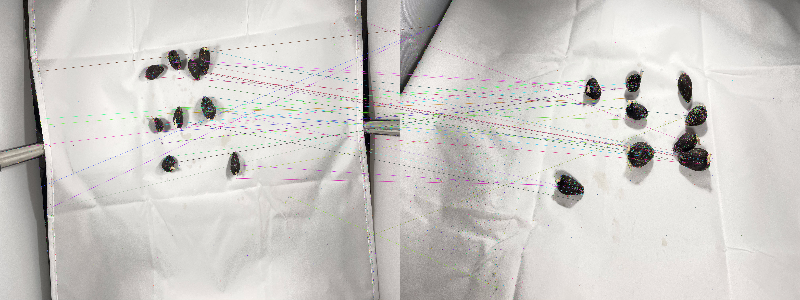

Total number of matches points: 
42
Coordinates of each matches points in Image 1: 
[(243.5626220703125, 1111.7421875), (329.5794982910156, 545.3265380859375), (405.38690185546875, 899.3870239257812), (415.01409912109375, 946.85205078125), (420.1586608886719, 1410.416015625), (441.0545654296875, 1594.529541015625), (478.99151611328125, 1584.920654296875), (1412.70654296875, 574.3634643554688), (1508.3564453125, 914.4520874023438), (1558.1502685546875, 999.5257568359375), (1602.01416015625, 946.2369995117188), (1635.6453857421875, 1083.6318359375), (1679.0721435546875, 857.5436401367188), (1697.7822265625, 1237.7122802734375), (1697.7822265625, 1237.7122802734375), (1728.122314453125, 1067.9146728515625), (1734.7952880859375, 469.80206298828125), (1741.4044189453125, 1180.6650390625), (1765.8787841796875, 451.4148864746094), (1786.498779296875, 821.0235595703125), (1826.52392578125, 811.0746459960938), (1895.070556640625, 921.5774536132812), (1930.1295166015625, 456.6328125), (2022.3985

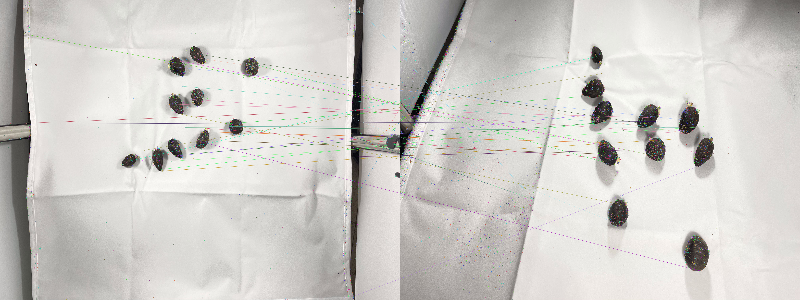

Total number of matches points: 
38
Coordinates of each matches points in Image 1: 
[(111.1916275024414, 937.8613891601562), (259.564697265625, 930.8780517578125), (282.57366943359375, 262.06463623046875), (1312.3984375, 1215.7462158203125), (1454.08935546875, 1135.5032958984375), (1625.64990234375, 1280.211181640625), (1638.3096923828125, 1292.11181640625), (1728.643798828125, 1218.220703125), (1777.90625, 787.7846069335938), (1785.3111572265625, 507.3841247558594), (1801.2103271484375, 1176.7978515625), (1820.0322265625, 460.6327819824219), (1831.0162353515625, 1165.98583984375), (1836.2763671875, 865.9276733398438), (1840.6868896484375, 652.0216674804688), (1872.97314453125, 963.643310546875), (1908.912353515625, 427.6903076171875), (1916.3668212890625, 749.8275756835938), (1989.8321533203125, 1064.005126953125), (2005.1890869140625, 410.0312194824219), (2044.69091796875, 1061.0947265625), (2044.69091796875, 1061.0947265625), (2056.73046875, 996.6166381835938), (2074.96142578125, 96

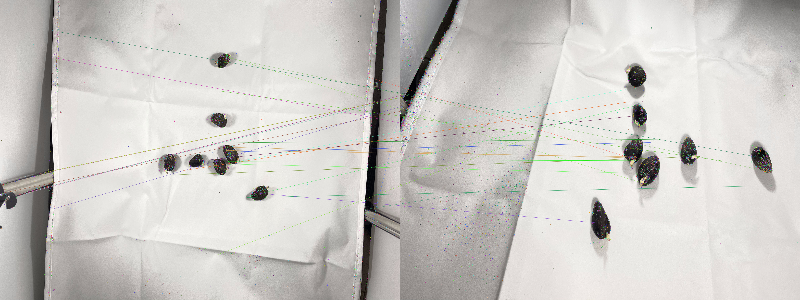

Total number of matches points: 
33
Coordinates of each matches points in Image 1: 
[(48.677085876464844, 1455.8704833984375), (198.61734008789062, 1471.957763671875), (266.437744140625, 1459.9774169921875), (286.5746765136719, 1449.7843017578125), (380.99871826171875, 1430.063720703125), (394.47137451171875, 1426.887451171875), (399.1396789550781, 1313.557861328125), (406.4427490234375, 1311.9290771484375), (456.800537109375, 1300.9984130859375), (543.8643188476562, 1577.5025634765625), (583.1839599609375, 441.38885498046875), (594.69873046875, 240.60218811035156), (1683.4403076171875, 1323.2572021484375), (1849.5103759765625, 1288.997314453125), (1849.5103759765625, 1288.997314453125), (1982.791748046875, 1217.2669677734375), (2141.325439453125, 1150.810546875), (2142.136474609375, 1079.8067626953125), (2177.37646484375, 1929.35498046875), (2228.5009765625, 689.0213012695312), (2235.0791015625, 416.6331481933594), (2278.20361328125, 1136.824462890625), (2305.308349609375, 1219.467895

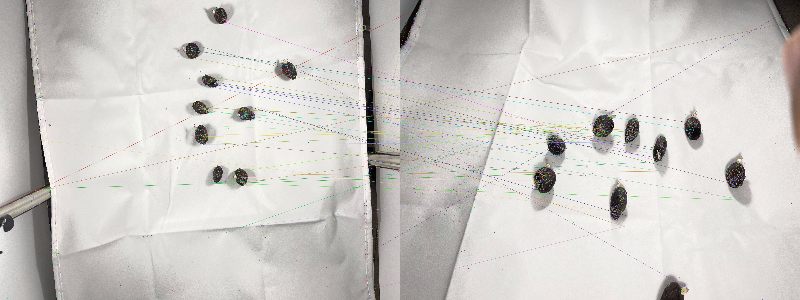

Total number of matches points: 
42
Coordinates of each matches points in Image 1: 
[(56.75605773925781, 1555.1947021484375), (362.4644775390625, 1441.1812744140625), (417.0795593261719, 1059.443603515625), (440.0684509277344, 1425.343017578125), (1891.1689453125, 815.3665771484375), (1891.1689453125, 815.3665771484375), (1899.0419921875, 328.41094970703125), (1938.9927978515625, 380.60528564453125), (1942.4114990234375, 381.5958557128906), (1942.4114990234375, 381.5958557128906), (1950.4993896484375, 438.8319091796875), (2014.25537109375, 813.2394409179688), (2029.4476318359375, 1021.2120361328125), (2031.404296875, 640.1581420898438), (2048.836669921875, 1032.621826171875), (2055.6708984375, 1090.2861328125), (2058.885009765625, 810.1452026367188), (2064.372802734375, 1091.33544921875), (2078.86328125, 847.9319458007812), (2098.605224609375, 1380.8988037109375), (2099.45556640625, 949.843994140625), (2110.3896484375, 615.4051513671875), (2117.553955078125, 581.069580078125), (2156.41

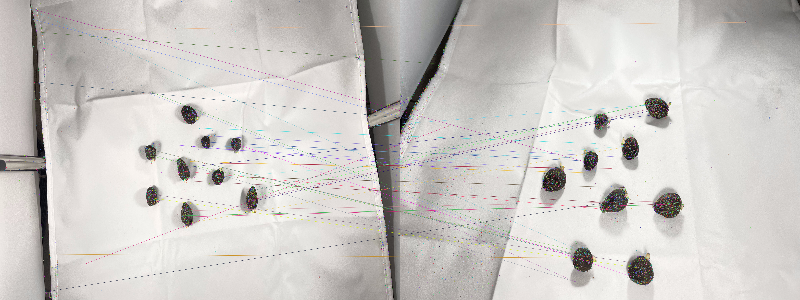

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(332.5331726074219, 81.22237396240234), (340.4237365722656, 147.61422729492188), (358.9374694824219, 74.81070709228516), (382.63421630859375, 242.3724822998047), (388.9111328125, 620.8145751953125), (459.122314453125, 2206.131591796875), (481.03863525390625, 227.5942840576172), (500.86700439453125, 1921.1927490234375), (868.1876220703125, 1991.4327392578125), (1413.8670654296875, 1137.8038330078125), (1494.1981201171875, 1126.6280517578125), (1494.1981201171875, 1126.6280517578125), (1497.769775390625, 1127.6771240234375), (1497.769775390625, 1127.6771240234375), (1507.9254150390625, 1493.5257568359375), (1519.647216796875, 1467.33349609375), (1524.2099609375, 711.6796264648438), (1527.3895263671875, 1179.544189453125), (1536.558349609375, 699.07958984375), (1743.3404541015625, 1093.7509765625), (1806.3956298828125, 1291.6357421875), (1850.9163818359375, 1629.9906005859375), (1850.9163818359375, 1629.9

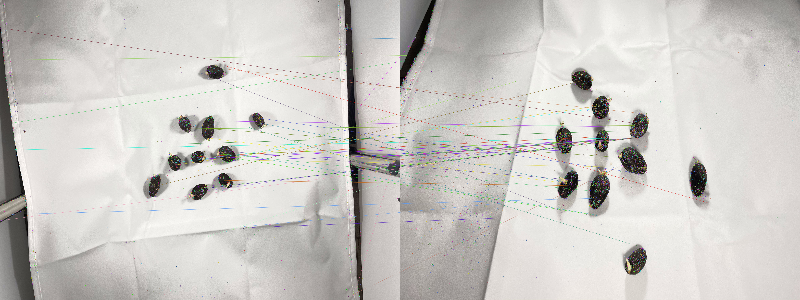

Total number of matches points: 
59
Coordinates of each matches points in Image 1: 
[(25.25846290588379, 1665.1396484375), (42.04435348510742, 452.9677734375), (70.8050537109375, 217.31500244140625), (122.14529418945312, 1620.549560546875), (123.1894302368164, 929.6971435546875), (156.4140167236328, 1132.677734375), (1556.5740966796875, 1408.996337890625), (1556.5740966796875, 1408.996337890625), (1763.928466796875, 1229.0343017578125), (1789.2103271484375, 1244.4140625), (1789.2103271484375, 1244.4140625), (1852.9888916015625, 911.077880859375), (1888.361328125, 974.3786010742188), (1892.4822998046875, 972.5806274414062), (1894.6307373046875, 1086.1810302734375), (1993.734375, 1189.4635009765625), (1995.938720703125, 1183.8402099609375), (2006.44091796875, 1450.3602294921875), (2018.090087890625, 1174.2786865234375), (2032.5252685546875, 1201.4932861328125), (2033.9163818359375, 553.98974609375), (2073.071533203125, 1423.375732421875), (2073.58349609375, 1418.2127685546875), (2076.603

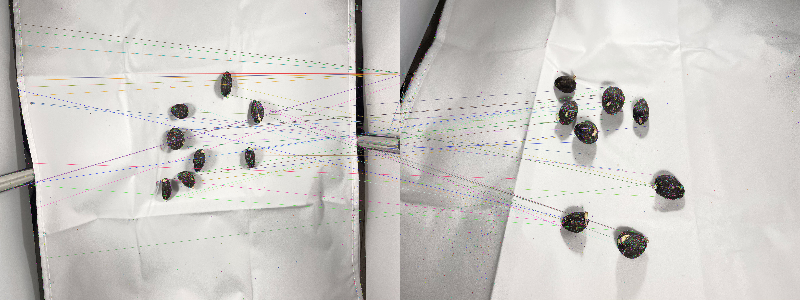

Total number of matches points: 
65
Coordinates of each matches points in Image 1: 
[(87.54886627197266, 1439.1783447265625), (137.83847045898438, 1427.072509765625), (145.5821533203125, 1424.844970703125), (160.93423461914062, 175.2541046142578), (161.75303649902344, 552.2862548828125), (164.6829071044922, 226.9180145263672), (166.70118713378906, 591.9124145507812), (168.63504028320312, 605.5670776367188), (172.13336181640625, 339.3788146972656), (176.15623474121094, 657.8671264648438), (176.59115600585938, 660.3512573242188), (176.61874389648438, 336.3704528808594), (185.9142608642578, 680.1439208984375), (186.47555541992188, 729.373291015625), (186.9538116455078, 729.574462890625), (215.14427185058594, 1407.05859375), (219.12896728515625, 1406.16259765625), (219.43846130371094, 1394.10888671875), (265.5272216796875, 1391.6085205078125), (286.8134460449219, 1232.6456298828125), (317.76177978515625, 780.0108032226562), (319.757568359375, 774.0032348632812), (370.68634033203125, 1573.3

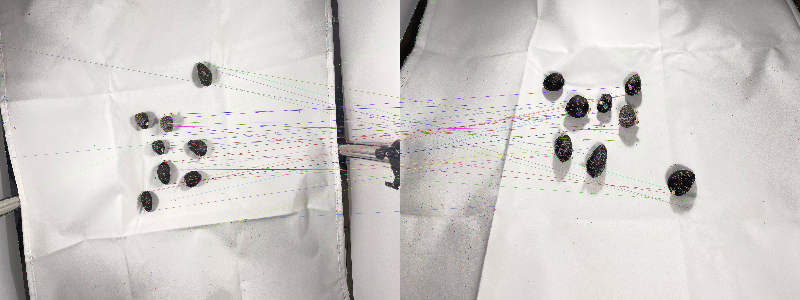

Total number of matches points: 
43
Coordinates of each matches points in Image 1: 
[(15.868228912353516, 347.800537109375), (66.12442016601562, 1195.949951171875), (127.88589477539062, 1498.1771240234375), (1436.3734130859375, 910.0192260742188), (1436.3734130859375, 910.0192260742188), (1491.8541259765625, 915.61767578125), (1491.8541259765625, 915.61767578125), (1498.6021728515625, 1447.9151611328125), (1501.6954345703125, 1453.040771484375), (1501.8992919921875, 1026.3060302734375), (1515.220947265625, 1593.0462646484375), (1542.2174072265625, 1595.3572998046875), (1599.3848876953125, 1279.2652587890625), (1634.0831298828125, 1117.9139404296875), (1649.4925537109375, 1028.8897705078125), (1657.433837890625, 863.9744873046875), (1660.1610107421875, 1310.0548095703125), (1660.1610107421875, 1310.0548095703125), (1662.241455078125, 1160.8873291015625), (1670.2562255859375, 1228.9559326171875), (1688.8115234375, 933.7356567382812), (1692.4339599609375, 1393.8194580078125), (1703.990234

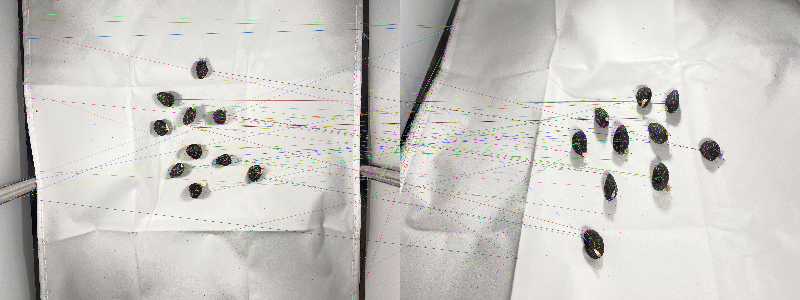

Total number of matches points: 
69
Coordinates of each matches points in Image 1: 
[(17.641071319580078, 1414.7879638671875), (54.951927185058594, 1404.62548828125), (68.82112121582031, 1403.631591796875), (103.0495834350586, 1510.28076171875), (188.15994262695312, 1493.9964599609375), (196.4139404296875, 240.24224853515625), (230.00234985351562, 680.0421752929688), (233.2435302734375, 1479.1119384765625), (244.45770263671875, 102.54428100585938), (247.32980346679688, 151.813720703125), (250.1774444580078, 737.7817993164062), (252.1585235595703, 292.1622009277344), (304.6132507324219, 1291.343505859375), (1612.66650390625, 764.1034545898438), (1617.596435546875, 964.9411010742188), (1646.2716064453125, 801.0144653320312), (1646.2716064453125, 801.0144653320312), (1686.6251220703125, 750.4743041992188), (1713.8917236328125, 756.5370483398438), (1747.8515625, 993.2517700195312), (1762.275390625, 967.8952026367188), (1775.2724609375, 1281.9771728515625), (1782.2142333984375, 1292.8615722

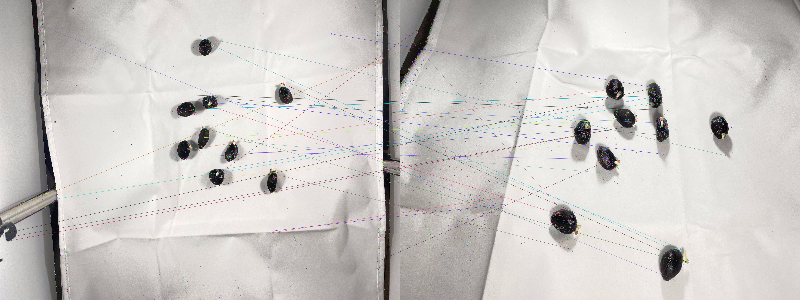

Total number of matches points: 
34
Coordinates of each matches points in Image 1: 
[(25.273468017578125, 1770.0963134765625), (91.42076110839844, 1820.8924560546875), (99.46489715576172, 1583.8729248046875), (154.36380004882812, 1784.413818359375), (424.42138671875, 196.58404541015625), (456.5340270996094, 1463.470703125), (538.614013671875, 1507.319091796875), (1848.8004150390625, 1135.505615234375), (1873.297607421875, 825.8419189453125), (1873.297607421875, 825.8419189453125), (1964.3416748046875, 719.4176025390625), (2017.8045654296875, 302.2781066894531), (2058.87451171875, 1039.5262451171875), (2062.5849609375, 968.8588256835938), (2096.533203125, 799.1641235351562), (2098.357177734375, 777.316162109375), (2101.784912109375, 731.9859008789062), (2135.802001953125, 1180.6734619140625), (2178.682373046875, 1288.610595703125), (2205.2353515625, 1313.802490234375), (2225.6259765625, 310.1640625), (2257.675048828125, 761.0345458984375), (2257.675048828125, 761.0345458984375), (2335.7

In [ ]:
# Image correspondence between top view and left view of good seeds
i = 1
while i < 11 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("left_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("___________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "left_S" + str(i) + " view of good seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and right_S1 view


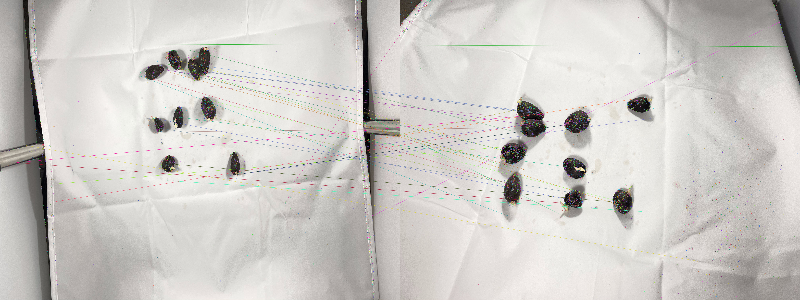

Total number of matches points: 
39
Coordinates of each matches points in Image 1: 
[(167.609130859375, 1229.3131103515625), (173.78514099121094, 1228.6011962890625), (265.7328186035156, 1099.5382080078125), (297.1084289550781, 330.0328674316406), (523.83203125, 1528.35498046875), (534.6588134765625, 1391.5546875), (1412.70654296875, 574.3634643554688), (1550.481689453125, 598.519775390625), (1565.6119384765625, 895.9402465820312), (1603.3385009765625, 997.816650390625), (1604.881103515625, 968.4033813476562), (1637.028564453125, 525.4798583984375), (1688.1861572265625, 1364.980712890625), (1688.1861572265625, 1364.980712890625), (1697.7822265625, 1237.7122802734375), (1698.0096435546875, 484.58148193359375), (1717.59521484375, 547.1738891601562), (1765.8787841796875, 451.4148864746094), (1807.2607421875, 545.9099731445312), (1809.4686279296875, 886.0380859375), (1814.9027099609375, 519.437744140625), (1904.62548828125, 378.8253479003906), (2037.307373046875, 496.2062683105469), (2049.

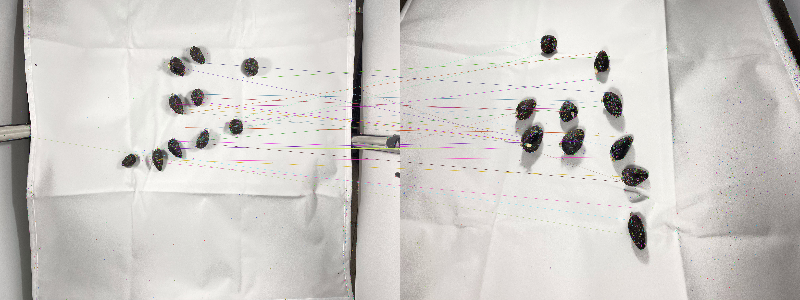

Total number of matches points: 
32
Coordinates of each matches points in Image 1: 
[(268.3626708984375, 1030.9173583984375), (1364.8798828125, 1144.60009765625), (1435.6317138671875, 1215.9793701171875), (1540.9876708984375, 1143.5814208984375), (1597.4327392578125, 1205.112548828125), (1709.627197265625, 1066.7816162109375), (1728.643798828125, 1218.220703125), (1735.54833984375, 708.9058227539062), (1767.4566650390625, 1119.421142578125), (1767.4566650390625, 1119.421142578125), (1773.6964111328125, 789.2096557617188), (1773.929931640625, 1123.126220703125), (1785.3111572265625, 507.3841247558594), (1786.385498046875, 839.08642578125), (1831.122802734375, 861.6559448242188), (1846.1376953125, 823.400634765625), (1872.97314453125, 963.643310546875), (1938.789794921875, 764.1404418945312), (1954.079345703125, 782.293212890625), (1992.7047119140625, 735.7877197265625), (1992.7047119140625, 735.7877197265625), (2020.4478759765625, 474.5501708984375), (2022.860595703125, 1082.33898925781

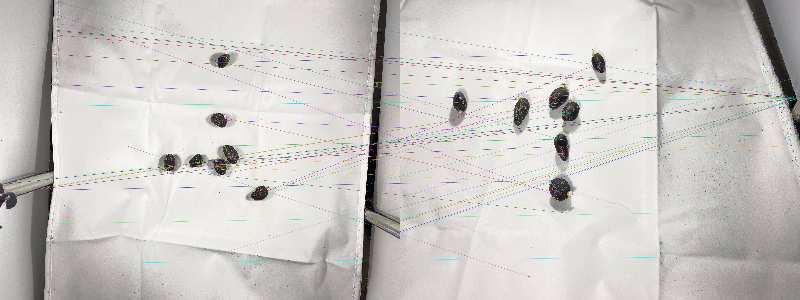

Total number of matches points: 
50
Coordinates of each matches points in Image 1: 
[(37.658836364746094, 1395.381591796875), (61.388519287109375, 1390.57763671875), (125.45970153808594, 1377.3480224609375), (317.8697204589844, 1439.3878173828125), (380.99871826171875, 1430.063720703125), (387.951171875, 1431.8731689453125), (394.47137451171875, 1426.887451171875), (397.6108703613281, 1429.6451416015625), (436.4102783203125, 1416.8729248046875), (511.0086669921875, 801.1273803710938), (525.1024169921875, 639.8461303710938), (527.4117431640625, 233.33624267578125), (528.0303955078125, 1690.8958740234375), (551.743896484375, 263.59747314453125), (552.3341064453125, 411.759521484375), (554.370849609375, 227.91293334960938), (556.2754516601562, 179.2738037109375), (589.1170654296875, 14.61093521118164), (601.9340209960938, 118.9446792602539), (1291.4329833984375, 1107.083251953125), (1421.6544189453125, 1984.863037109375), (1592.299560546875, 1276.578857421875), (1620.30419921875, 1292.567

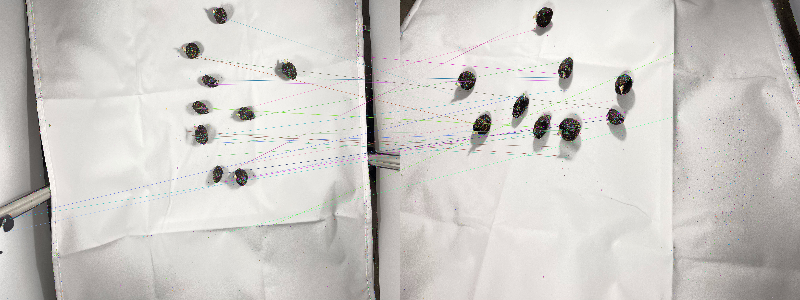

Total number of matches points: 
31
Coordinates of each matches points in Image 1: 
[(45.111236572265625, 1658.8720703125), (62.3486213684082, 1753.963134765625), (128.32028198242188, 1645.759765625), (1884.0789794921875, 1034.46826171875), (1884.5399169921875, 992.2301635742188), (1891.1689453125, 815.3665771484375), (1910.107666015625, 412.56011962890625), (1936.524169921875, 1023.4227905273438), (1968.9478759765625, 440.0785217285156), (1999.5179443359375, 414.72894287109375), (2014.25537109375, 813.2394409179688), (2029.4476318359375, 1021.2120361328125), (2031.404296875, 640.1581420898438), (2047.0655517578125, 612.4121704101562), (2061.723388671875, 1082.4598388671875), (2094.595703125, 1181.5767822265625), (2103.981689453125, 96.35101318359375), (2157.432861328125, 1021.5264282226562), (2192.972412109375, 1316.5281982421875), (2192.972412109375, 1316.5281982421875), (2225.220458984375, 1330.7200927734375), (2265.075439453125, 1761.3331298828125), (2270.91455078125, 1372.94897460

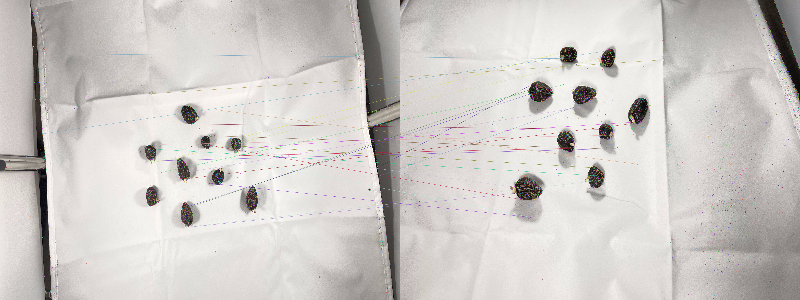

Total number of matches points: 
28
Coordinates of each matches points in Image 1: 
[(386.7334289550781, 405.0422058105469), (429.0755920410156, 1011.6923828125), (1499.412109375, 1124.583984375), (1517.8848876953125, 707.824951171875), (1527.0006103515625, 1232.4945068359375), (1560.44921875, 1215.6878662109375), (1610.8369140625, 1091.886962890625), (1610.8369140625, 1091.886962890625), (1624.7591552734375, 1303.797607421875), (1874.16845703125, 1567.1312255859375), (1874.16845703125, 1567.1312255859375), (1879.4287109375, 1716.299560546875), (1895.448486328125, 1717.62646484375), (1896.9974365234375, 1570.88134765625), (1904.0042724609375, 1348.761962890625), (1914.4073486328125, 936.848388671875), (1921.0975341796875, 1297.4150390625), (2066.38671875, 1096.2376708984375), (2109.187255859375, 1384.475830078125), (2115.88232421875, 1098.3858642578125), (2161.176025390625, 1027.134521484375), (2178.600830078125, 829.7135009765625), (2205.25830078125, 1179.570068359375), (2362.11645507

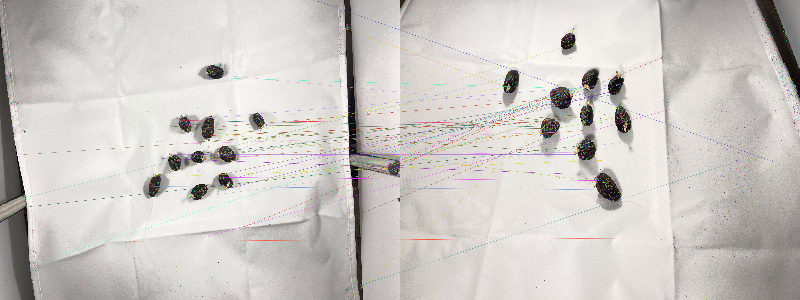

Total number of matches points: 
62
Coordinates of each matches points in Image 1: 
[(82.80986785888672, 1527.1217041015625), (162.66490173339844, 1172.2020263671875), (266.858154296875, 1564.4222412109375), (301.37493896484375, 2003.35595703125), (1347.080322265625, 1824.25048828125), (1556.5740966796875, 1408.996337890625), (1565.4200439453125, 1336.0360107421875), (1590.4854736328125, 1320.2357177734375), (1635.9405517578125, 1198.0277099609375), (1703.60888671875, 1166.5655517578125), (1734.713134765625, 954.004638671875), (1734.713134765625, 954.004638671875), (1746.91845703125, 1332.7225341796875), (1827.3319091796875, 910.9895629882812), (1827.6556396484375, 1216.9151611328125), (1846.18603515625, 910.5482788085938), (1863.9339599609375, 939.2401123046875), (1874.985107421875, 976.677734375), (1893.183837890625, 1499.078125), (1893.183837890625, 1499.078125), (1894.6307373046875, 1086.1810302734375), (1920.92431640625, 1213.3526611328125), (1959.4884033203125, 1181.138427734375)

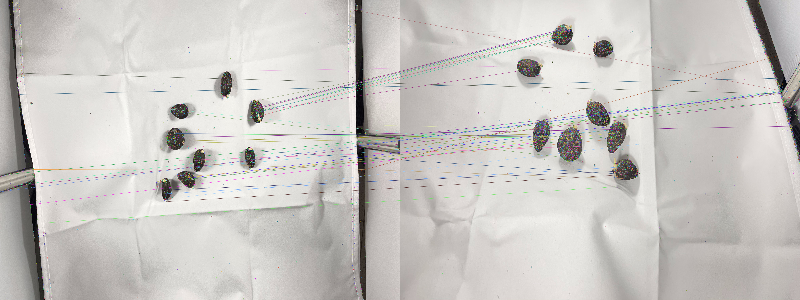

Total number of matches points: 
51
Coordinates of each matches points in Image 1: 
[(2.668698787689209, 1449.6141357421875), (116.50761413574219, 1315.2789306640625), (144.66802978515625, 1409.683349609375), (161.75303649902344, 552.2862548828125), (196.81256103515625, 713.623291015625), (219.43846130371094, 1394.10888671875), (305.4044189453125, 1546.982177734375), (331.9354248046875, 1281.3211669921875), (424.5219421386719, 1686.3154296875), (1668.3572998046875, 1464.1890869140625), (1674.3768310546875, 1524.2423095703125), (1681.6365966796875, 1435.401611328125), (1731.777587890625, 826.1239013671875), (1758.88623046875, 1008.837646484375), (1766.4691162109375, 1009.4080200195312), (1769.5037841796875, 1082.4005126953125), (1769.5037841796875, 1082.4005126953125), (1772.2559814453125, 1008.6448974609375), (1780.3272705078125, 1065.786376953125), (1781.9093017578125, 846.1578369140625), (1810.9566650390625, 1212.39111328125), (1835.7100830078125, 1338.424072265625), (1840.4420166015

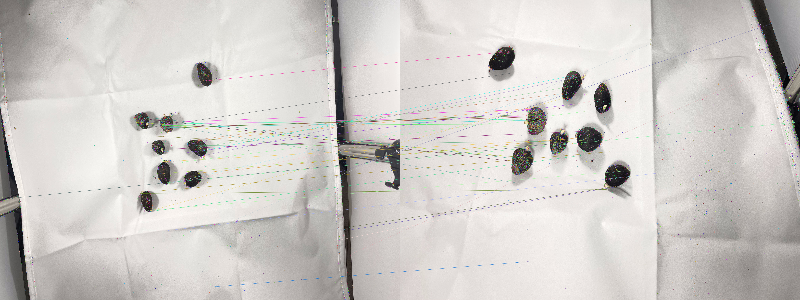

Total number of matches points: 
45
Coordinates of each matches points in Image 1: 
[(127.88589477539062, 1498.1771240234375), (1320.874755859375, 904.9495849609375), (1387.51318359375, 976.9629516601562), (1391.6431884765625, 891.87646484375), (1402.7401123046875, 880.3255615234375), (1414.6051025390625, 1462.2923583984375), (1419.6649169921875, 925.1080322265625), (1501.8992919921875, 1026.3060302734375), (1515.220947265625, 1593.0462646484375), (1542.2174072265625, 1595.3572998046875), (1555.438232421875, 1586.050048828125), (1566.325439453125, 1104.55419921875), (1613.3839111328125, 1442.0677490234375), (1634.3272705078125, 948.0460205078125), (1646.0635986328125, 1221.6785888671875), (1654.0579833984375, 964.4136352539062), (1657.0863037109375, 1128.0484619140625), (1657.4097900390625, 936.197021484375), (1660.1610107421875, 1310.0548095703125), (1665.3724365234375, 1392.8294677734375), (1670.065185546875, 940.9192504882812), (1670.132568359375, 962.7876586914062), (1670.132568359

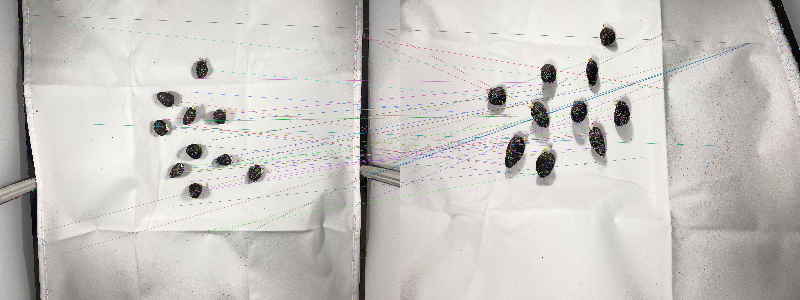

Total number of matches points: 
58
Coordinates of each matches points in Image 1: 
[(259.0412292480469, 152.42044067382812), (270.1590576171875, 113.96209716796875), (422.09442138671875, 1749.3275146484375), (455.95904541015625, 1956.0394287109375), (955.1465454101562, 939.407470703125), (1552.0443115234375, 944.8709716796875), (1635.6009521484375, 952.029541015625), (1643.740478515625, 905.828857421875), (1657.5548095703125, 905.9691162109375), (1686.6251220703125, 750.4743041992188), (1747.34814453125, 1559.3516845703125), (1761.537109375, 1277.5909423828125), (1762.275390625, 967.8952026367188), (1787.702880859375, 1313.036865234375), (1791.5755615234375, 1310.9119873046875), (1792.0830078125, 1302.8408203125), (1794.9383544921875, 1298.0960693359375), (1795.977294921875, 789.5250244140625), (1822.282470703125, 1260.2620849609375), (1854.9443359375, 1378.5216064453125), (1863.5869140625, 944.2799682617188), (1885.1259765625, 913.53662109375), (1888.3973388671875, 887.322509765625),

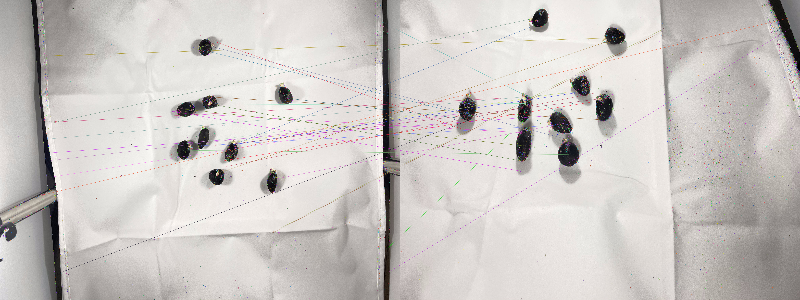

Total number of matches points: 
36
Coordinates of each matches points in Image 1: 
[(426.5523376464844, 1474.2169189453125), (464.4359130859375, 422.1254577636719), (479.4855651855469, 1050.87255859375), (503.58740234375, 1155.3826904296875), (514.4067993164062, 1212.6458740234375), (546.2896728515625, 1334.8426513671875), (550.5349731445312, 923.9855346679688), (555.8922729492188, 2074.562744140625), (558.5877685546875, 921.8338623046875), (1736.308837890625, 840.2515258789062), (1848.8004150390625, 1135.505615234375), (1852.1221923828125, 1088.511962890625), (1873.297607421875, 825.8419189453125), (1873.297607421875, 825.8419189453125), (1947.6480712890625, 860.0505981445312), (2019.966796875, 373.44580078125), (2030.8499755859375, 1101.4580078125), (2096.58740234375, 792.5806274414062), (2101.784912109375, 731.9859008789062), (2150.222900390625, 353.8247375488281), (2191.69189453125, 1310.3565673828125), (2192.98876953125, 795.8319702148438), (2194.48779296875, 321.68487548828125),

In [ ]:
# Image correspondence between top view and right view of good seeds
i = 1
while i < 11 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("right_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "right_S" + str(i) + " view of good seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and rear_S1 view


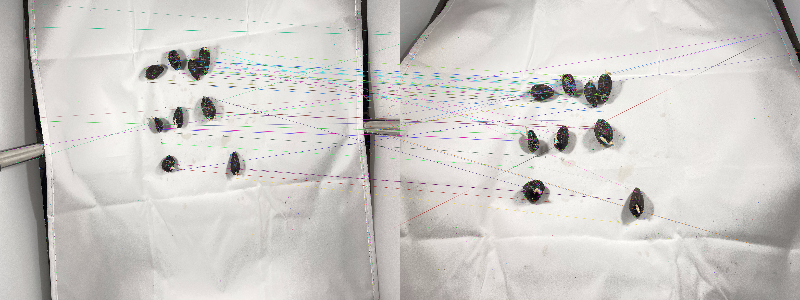

Total number of matches points: 
61
Coordinates of each matches points in Image 1: 
[(125.4253921508789, 1131.6927490234375), (295.2787780761719, 1214.632080078125), (301.6028747558594, 24.525676727294922), (327.53704833984375, 204.5720672607422), (403.50634765625, 889.3888549804688), (408.4085693359375, 915.0407104492188), (1483.0455322265625, 620.993896484375), (1485.4127197265625, 599.322021484375), (1602.01416015625, 946.2369995117188), (1602.59716796875, 977.00146484375), (1604.881103515625, 968.4033813476562), (1604.881103515625, 968.4033813476562), (1635.6453857421875, 1083.6318359375), (1679.421630859375, 511.0992126464844), (1679.947021484375, 397.8500671386719), (1697.7822265625, 1237.7122802734375), (1702.6788330078125, 1003.7410888671875), (1730.4647216796875, 1295.4490966796875), (1765.8787841796875, 451.4148864746094), (1765.8787841796875, 451.4148864746094), (1777.030517578125, 455.53765869140625), (1783.586669921875, 952.2391967773438), (1804.4718017578125, 1279.5795898

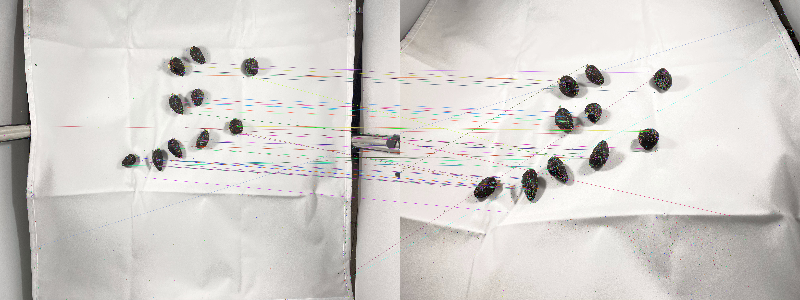

Total number of matches points: 
56
Coordinates of each matches points in Image 1: 
[(285.13922119140625, 951.1869506835938), (306.5289611816406, 1881.5372314453125), (1238.492431640625, 1252.3101806640625), (1312.3984375, 1215.7462158203125), (1314.6058349609375, 1264.9229736328125), (1394.09130859375, 1193.2772216796875), (1468.143310546875, 1342.356689453125), (1571.851318359375, 1209.9744873046875), (1578.067626953125, 1205.1361083984375), (1594.7701416015625, 1256.8963623046875), (1594.7701416015625, 1256.8963623046875), (1597.4327392578125, 1205.112548828125), (1599.2098388671875, 1252.4273681640625), (1599.2098388671875, 1252.4273681640625), (1599.2098388671875, 1252.4273681640625), (1599.5064697265625, 1256.0391845703125), (1599.5064697265625, 1256.0391845703125), (1651.963134765625, 1207.806640625), (1695.5361328125, 1088.31005859375), (1707.432861328125, 496.9158630371094), (1728.643798828125, 1218.220703125), (1758.845947265625, 843.3956909179688), (1764.1749267578125, 772.0

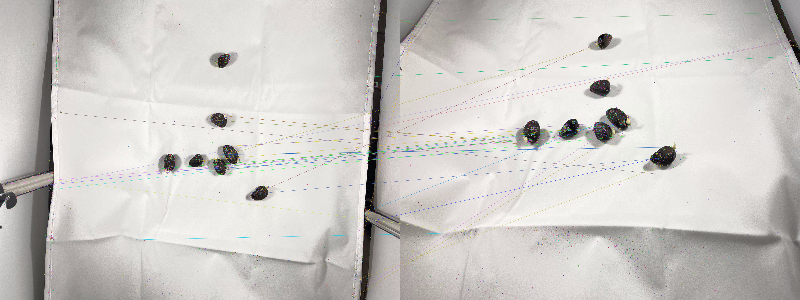

Total number of matches points: 
34
Coordinates of each matches points in Image 1: 
[(37.654991149902344, 1392.216064453125), (452.3620910644531, 1403.153564453125), (477.06634521484375, 1399.1036376953125), (532.2277221679688, 1357.281494140625), (533.4165649414062, 1431.914306640625), (607.882080078125, 852.9169311523438), (1378.6263427734375, 1811.9654541015625), (1592.299560546875, 1276.578857421875), (1746.431884765625, 1308.6236572265625), (1849.5103759765625, 1288.997314453125), (1982.791748046875, 1217.2669677734375), (2037.29052734375, 1171.2103271484375), (2058.233642578125, 1220.7357177734375), (2087.403564453125, 904.3551025390625), (2196.14990234375, 1256.7432861328125), (2204.33935546875, 1319.6375732421875), (2210.1396484375, 1287.916015625), (2215.58203125, 1262.7835693359375), (2233.4970703125, 1106.4962158203125), (2255.399169921875, 874.8606567382812), (2310.70263671875, 1106.9908447265625), (2492.178955078125, 1492.991943359375), (2621.669677734375, 1461.8544921875)

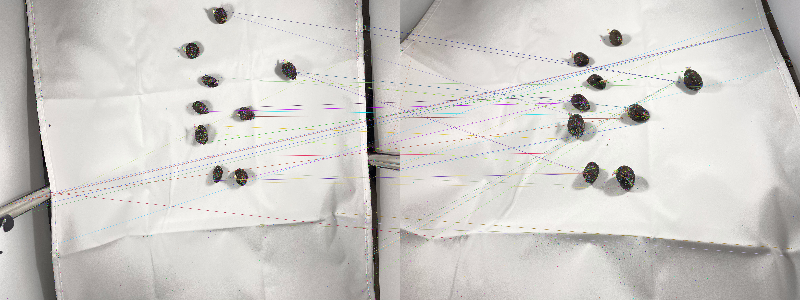

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(56.75605773925781, 1555.1947021484375), (91.31848907470703, 1543.584716796875), (162.70016479492188, 1633.3575439453125), (168.40440368652344, 1517.4893798828125), (304.9490966796875, 1579.390869140625), (321.8624572753906, 1500.474853515625), (362.4644775390625, 1441.1812744140625), (389.0679931640625, 1554.367919921875), (523.4022827148438, 1855.52490234375), (2040.563720703125, 608.7081909179688), (2046.777099609375, 1079.6278076171875), (2051.92529296875, 844.1535034179688), (2058.72607421875, 1000.3056640625), (2065.310546875, 841.2135620117188), (2073.44384765625, 577.3507690429688), (2093.132568359375, 836.3406982421875), (2094.595703125, 1181.5767822265625), (2099.45556640625, 949.843994140625), (2159.19384765625, 71.90450286865234), (2170.480712890625, 1364.39208984375), (2173.134765625, 1360.5302734375), (2174.875, 82.98157501220703), (2192.972412109375, 1316.5281982421875), (2270.9145507812

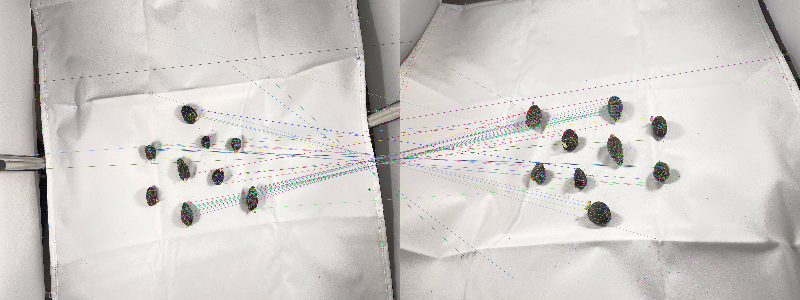

Total number of matches points: 
65
Coordinates of each matches points in Image 1: 
[(249.79714965820312, 1172.3206787109375), (315.8220520019531, 1174.150390625), (317.8252258300781, 66.93574523925781), (367.2593688964844, 1278.0325927734375), (388.9111328125, 620.8145751953125), (1506.96044921875, 1127.367431640625), (1506.96044921875, 1127.367431640625), (1510.18603515625, 1126.8251953125), (1518.607421875, 1134.65478515625), (1524.2099609375, 711.6796264648438), (1544.987060546875, 1082.8077392578125), (1545.2071533203125, 1205.781982421875), (1575.7215576171875, 1116.5797119140625), (1610.8369140625, 1091.886962890625), (1743.3404541015625, 1093.7509765625), (1842.3319091796875, 811.9923706054688), (1850.367919921875, 845.0247802734375), (1861.29541015625, 1586.833984375), (1869.5230712890625, 1598.4993896484375), (1874.16845703125, 1567.1312255859375), (1874.16845703125, 1567.1312255859375), (1874.5045166015625, 1578.7801513671875), (1877.3961181640625, 1630.719482421875), (1878.

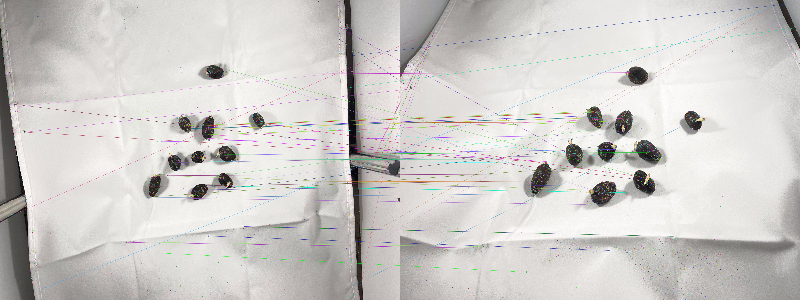

Total number of matches points: 
64
Coordinates of each matches points in Image 1: 
[(99.1253662109375, 784.3545532226562), (101.05992889404297, 812.5805053710938), (186.46104431152344, 1606.009033203125), (247.6876983642578, 998.6304931640625), (252.39703369140625, 998.9488525390625), (407.30963134765625, 2187.59619140625), (1271.6739501953125, 1831.573974609375), (1308.27880859375, 1828.7850341796875), (1483.9354248046875, 1494.608154296875), (1556.5740966796875, 1408.996337890625), (1563.5909423828125, 1485.76318359375), (1580.8203125, 1325.9620361328125), (1623.7437744140625, 1070.5760498046875), (1632.136474609375, 1913.1102294921875), (1686.375, 1375.8082275390625), (1686.375, 1375.8082275390625), (1690.9300537109375, 1327.1370849609375), (1763.928466796875, 1229.0343017578125), (1856.510498046875, 955.1509399414062), (1857.5079345703125, 950.05029296875), (1861.0816650390625, 955.4324340820312), (1874.249267578125, 969.5248413085938), (1886.46044921875, 977.1297607421875), (1886

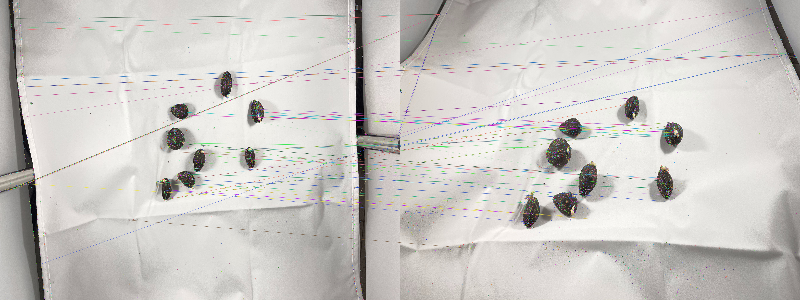

Total number of matches points: 
65
Coordinates of each matches points in Image 1: 
[(68.35879516601562, 1443.38427734375), (87.54886627197266, 1439.1783447265625), (104.7568588256836, 1435.326904296875), (113.65845489501953, 1432.275634765625), (118.07469940185547, 201.7633056640625), (137.83847045898438, 1427.072509765625), (145.5821533203125, 1424.844970703125), (160.93423461914062, 175.2541046142578), (161.2043914794922, 138.8270263671875), (164.6829071044922, 226.9180145263672), (168.63504028320312, 605.5670776367188), (176.15623474121094, 657.8671264648438), (176.59115600585938, 660.3512573242188), (186.47555541992188, 729.373291015625), (186.9538116455078, 729.574462890625), (215.14427185058594, 1407.05859375), (219.12896728515625, 1406.16259765625), (230.04481506347656, 885.50341796875), (237.9960174560547, 1388.876953125), (414.3074951171875, 1994.9326171875), (1302.7506103515625, 1663.3516845703125), (1587.00927734375, 1374.369140625), (1592.3311767578125, 1385.5318603515625)

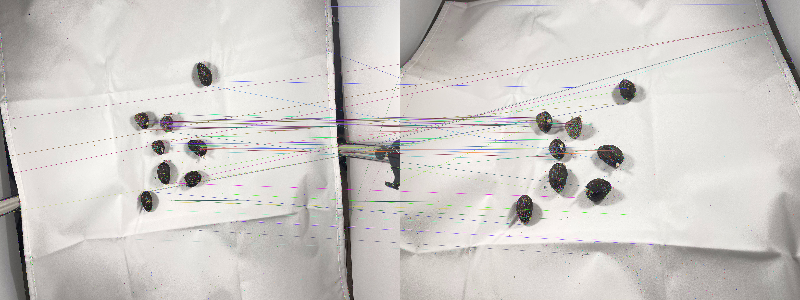

Total number of matches points: 
69
Coordinates of each matches points in Image 1: 
[(27.753408432006836, 906.8782958984375), (99.62650299072266, 1178.95556640625), (136.7961883544922, 1307.5284423828125), (139.04840087890625, 1599.174072265625), (1180.8182373046875, 1804.1470947265625), (1387.51318359375, 976.9629516601562), (1427.4901123046875, 858.1431274414062), (1433.6793212890625, 927.9213256835938), (1443.099365234375, 921.2314453125), (1443.099365234375, 921.2314453125), (1443.4971923828125, 930.5470581054688), (1447.9830322265625, 940.7249145507812), (1449.7589111328125, 916.8599243164062), (1449.7589111328125, 916.8599243164062), (1450.5772705078125, 1445.4906005859375), (1454.7305908203125, 909.912841796875), (1483.4388427734375, 1523.177001953125), (1498.6021728515625, 1447.9151611328125), (1499.9090576171875, 1444.8961181640625), (1501.8992919921875, 1026.3060302734375), (1507.9227294921875, 1448.088623046875), (1508.2816162109375, 1512.763671875), (1508.2816162109375, 151

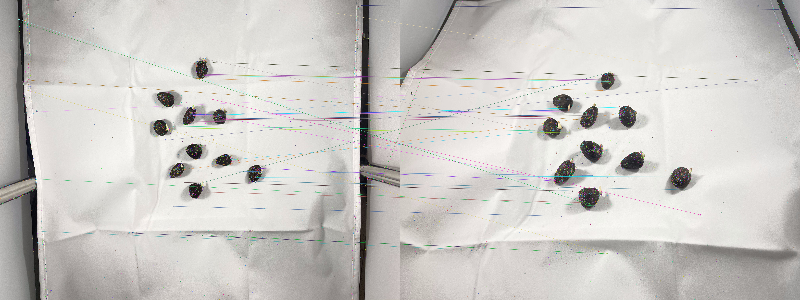

Total number of matches points: 
48
Coordinates of each matches points in Image 1: 
[(188.93894958496094, 145.51475524902344), (190.24652099609375, 163.95779418945312), (273.76580810546875, 681.1629028320312), (300.63165283203125, 606.3955078125), (307.04510498046875, 1350.636474609375), (379.9281005859375, 844.8753662109375), (422.09442138671875, 1749.3275146484375), (1296.7259521484375, 1761.3131103515625), (1671.1748046875, 1059.0380859375), (1745.7470703125, 953.6178588867188), (1747.34814453125, 1559.3516845703125), (1762.275390625, 967.8952026367188), (1791.1859130859375, 1287.8792724609375), (1854.9443359375, 1378.5216064453125), (1884.2591552734375, 906.7495727539062), (1891.6470947265625, 907.5648193359375), (1891.6470947265625, 907.5648193359375), (1892.43701171875, 900.8196411132812), (1892.43701171875, 900.8196411132812), (1899.8797607421875, 919.654296875), (1923.6282958984375, 866.0152587890625), (1941.8154296875, 846.943115234375), (1947.7930908203125, 872.7057495117188)

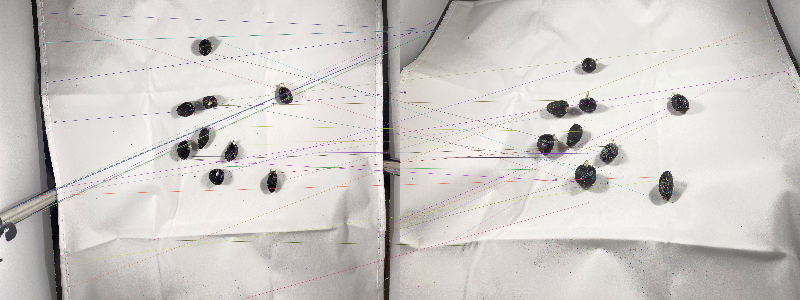

Total number of matches points: 
53
Coordinates of each matches points in Image 1: 
[(107.92191314697266, 1581.1011962890625), (112.50343322753906, 1579.45703125), (124.74227905273438, 1567.26513671875), (156.40577697753906, 1563.973876953125), (163.4803009033203, 1679.3560791015625), (178.1913604736328, 1556.5814208984375), (188.78277587890625, 1668.0919189453125), (193.4019317626953, 1551.0452880859375), (203.1279754638672, 1679.189453125), (210.9700927734375, 1535.6690673828125), (227.96783447265625, 1653.3328857421875), (320.9261779785156, 1618.7188720703125), (339.5625305175781, 1496.912841796875), (369.2279968261719, 1487.9351806640625), (400.0362243652344, 96.87342834472656), (409.26708984375, 1477.8709716796875), (413.6084899902344, 322.8464660644531), (416.2786865234375, 319.521728515625), (419.5819091796875, 111.47249603271484), (432.16680908203125, 1582.8441162109375), (433.86993408203125, 627.266845703125), (449.2718505859375, 1575.7117919921875), (478.21612548828125, 1432.

In [ ]:
# Image correspondence between top view and rear view of good seeds
i = 1
while i < 11 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("rear_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "rear_S" + str(i) + " view of good seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and front_S1 view


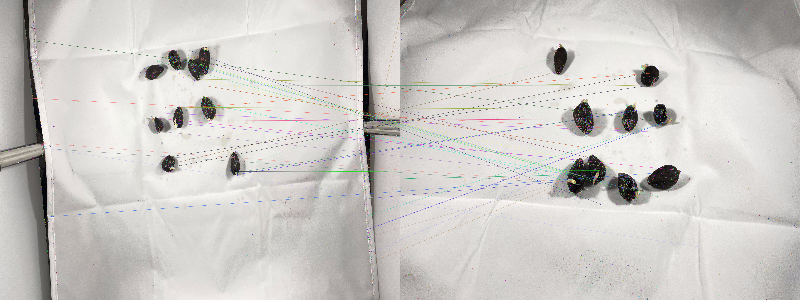

Total number of matches points: 
42
Coordinates of each matches points in Image 1: 
[(243.5626220703125, 1111.7421875), (265.7328186035156, 1099.5382080078125), (328.81524658203125, 742.8582153320312), (349.44464111328125, 642.1637573242188), (362.6903076171875, 310.4248352050781), (436.24591064453125, 1083.95556640625), (444.4156188964844, 1640.372802734375), (1560.3731689453125, 891.2216186523438), (1568.5159912109375, 593.7691650390625), (1586.97314453125, 461.2259521484375), (1601.6290283203125, 992.2359619140625), (1679.0721435546875, 857.5436401367188), (1717.59521484375, 547.1738891601562), (1725.6038818359375, 914.8068237304688), (1741.4044189453125, 1180.6650390625), (1765.8787841796875, 451.4148864746094), (1778.1871337890625, 931.1516723632812), (1807.2850341796875, 1253.356201171875), (1820.803466796875, 1221.162109375), (1825.8826904296875, 818.3348388671875), (1826.52392578125, 811.0746459960938), (1865.2847900390625, 462.31829833984375), (1904.62548828125, 378.8253479003

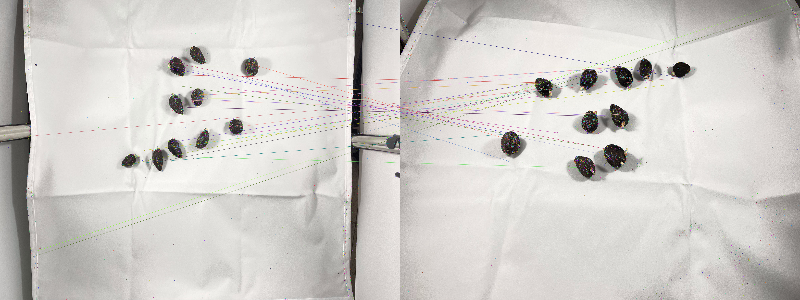

Total number of matches points: 
33
Coordinates of each matches points in Image 1: 
[(268.3626708984375, 1030.9173583984375), (312.0690002441406, 1945.590576171875), (374.8494873046875, 1896.12060546875), (1093.9481201171875, 737.5797729492188), (1230.7950439453125, 1243.385986328125), (1238.492431640625, 1252.3101806640625), (1454.08935546875, 1135.5032958984375), (1552.92724609375, 1228.654052734375), (1710.746337890625, 513.7706909179688), (1713.9052734375, 468.8168640136719), (1730.9639892578125, 1075.0948486328125), (1757.077880859375, 743.8118896484375), (1766.044677734375, 1183.904296875), (1767.4566650390625, 1119.421142578125), (1770.1263427734375, 753.8101806640625), (1785.3111572265625, 507.3841247558594), (1809.61083984375, 566.7678833007812), (1840.6868896484375, 652.0216674804688), (1891.8084716796875, 811.9760131835938), (1937.9139404296875, 716.8591918945312), (1969.0279541015625, 504.0483093261719), (2047.91943359375, 718.332763671875), (2047.91943359375, 718.332763671

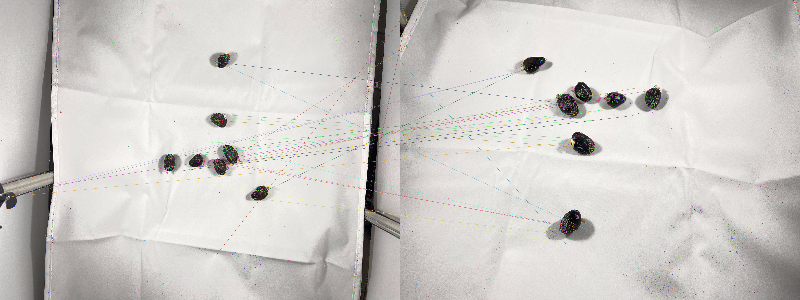

Total number of matches points: 
37
Coordinates of each matches points in Image 1: 
[(96.4463882446289, 1487.4591064453125), (242.13934326171875, 1469.304443359375), (379.5433044433594, 1423.2044677734375), (493.6485900878906, 1407.5694580078125), (616.1573486328125, 852.6619262695312), (1678.07275390625, 1195.3924560546875), (1683.4403076171875, 1323.2572021484375), (1849.5103759765625, 1288.997314453125), (1849.5103759765625, 1288.997314453125), (1981.1883544921875, 1202.4661865234375), (1998.5771484375, 1262.6695556640625), (2019.7646484375, 1260.2532958984375), (2037.29052734375, 1171.2103271484375), (2087.403564453125, 904.3551025390625), (2103.770751953125, 1225.4737548828125), (2139.569091796875, 451.0726318359375), (2139.569091796875, 451.0726318359375), (2141.065673828125, 1208.5416259765625), (2142.136474609375, 1079.8067626953125), (2177.37646484375, 1929.35498046875), (2191.6474609375, 470.4622497558594), (2215.58203125, 1262.7835693359375), (2215.58203125, 1262.78356933593

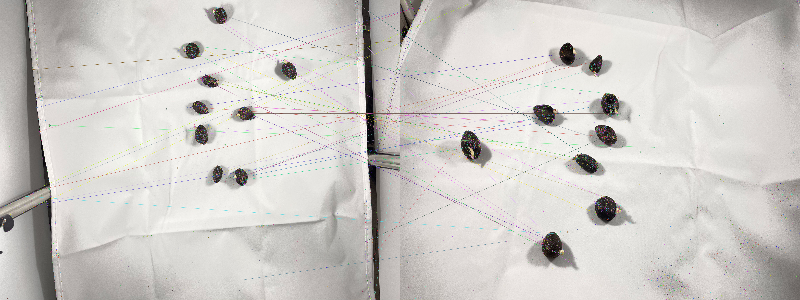

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(121.88142395019531, 1571.54736328125), (263.9604797363281, 1484.462890625), (329.42596435546875, 525.529296875), (369.306640625, 814.383544921875), (395.9070129394531, 995.1994018554688), (396.7769470214844, 1548.0509033203125), (412.666748046875, 1535.4595947265625), (440.0684509277344, 1425.343017578125), (450.5790100097656, 1401.2261962890625), (451.8164367675781, 1427.3394775390625), (500.98883056640625, 946.932861328125), (1889.51953125, 341.3232116699219), (1891.1689453125, 815.3665771484375), (1934.203125, 383.31707763671875), (2014.25537109375, 813.2394409179688), (2020.09765625, 1016.1778564453125), (2029.83837890625, 590.4544677734375), (2046.3092041015625, 373.5966796875), (2067.478271484375, 610.453857421875), (2070.56640625, 116.47313690185547), (2077.1337890625, 78.84770965576172), (2098.605224609375, 1380.8988037109375), (2110.3896484375, 615.4051513671875), (2117.553955078125, 581.0695

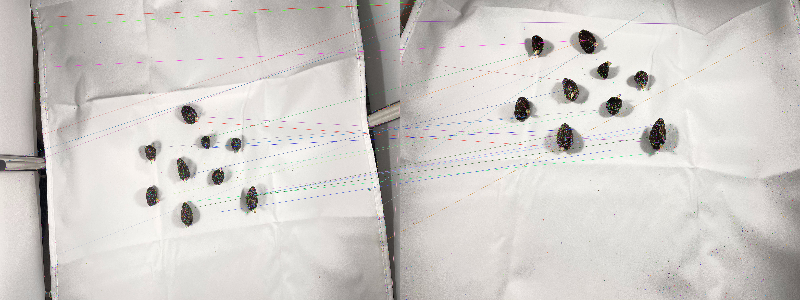

Total number of matches points: 
34
Coordinates of each matches points in Image 1: 
[(78.99227142333984, 1292.1229248046875), (95.5107192993164, 1216.0343017578125), (338.15301513671875, 131.86289978027344), (356.5010070800781, 207.96266174316406), (430.0791931152344, 1016.3822021484375), (457.37322998046875, 507.1477355957031), (505.5363464355469, 1944.7342529296875), (1575.7215576171875, 1116.5797119140625), (1757.5799560546875, 1462.913818359375), (1880.160400390625, 1324.607421875), (1889.0592041015625, 1580.26220703125), (1894.7479248046875, 1524.6593017578125), (1967.9930419921875, 917.5689086914062), (1980.0108642578125, 880.8026123046875), (2046.806640625, 1119.2685546875), (2119.1123046875, 1111.4964599609375), (2161.176025390625, 1027.134521484375), (2213.519775390625, 1317.1273193359375), (2215.750732421875, 1601.682373046875), (2215.750732421875, 1601.682373046875), (2482.868408203125, 1455.509521484375), (2503.48828125, 1487.839599609375), (2531.536865234375, 1475.98120117

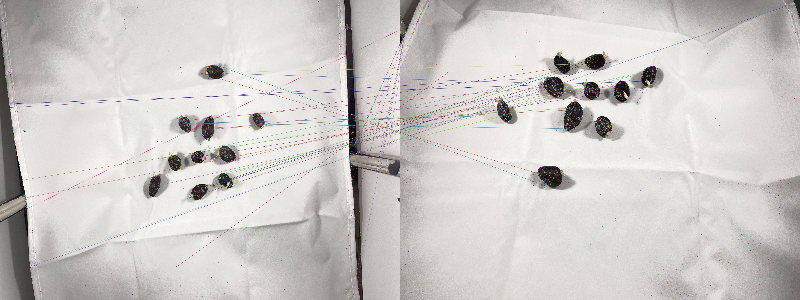

Total number of matches points: 
53
Coordinates of each matches points in Image 1: 
[(99.1253662109375, 784.3545532226562), (101.05992889404297, 812.5805053710938), (156.38230895996094, 1619.0987548828125), (223.7819061279297, 1361.843505859375), (245.20669555664062, 1497.98095703125), (301.37493896484375, 2003.35595703125), (347.2293701171875, 2003.6446533203125), (1556.5740966796875, 1408.996337890625), (1556.5740966796875, 1408.996337890625), (1779.2962646484375, 2016.904296875), (1779.2962646484375, 2016.904296875), (1803.04345703125, 914.8585205078125), (1848.1387939453125, 932.9564819335938), (1893.183837890625, 1499.078125), (1916.0533447265625, 1169.835693359375), (1916.8331298828125, 997.3955688476562), (1939.263671875, 1192.302001953125), (1976.4447021484375, 931.615234375), (1984.9493408203125, 1142.572021484375), (2033.9163818359375, 553.98974609375), (2063.33447265625, 1415.597412109375), (2063.33447265625, 1415.597412109375), (2081.630126953125, 968.4679565429688), (2090.

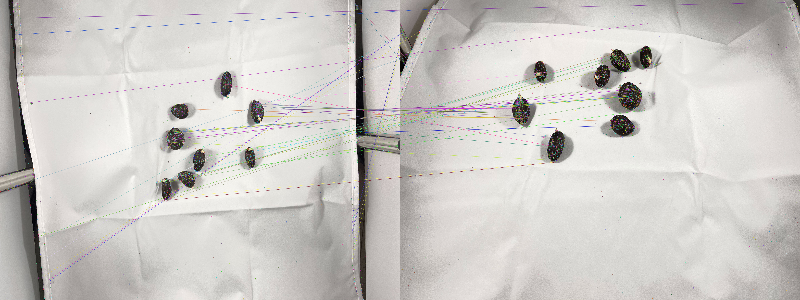

Total number of matches points: 
63
Coordinates of each matches points in Image 1: 
[(189.9086151123047, 260.6475524902344), (200.18724060058594, 135.67247009277344), (319.757568359375, 774.0032348632812), (348.8809509277344, 1356.1728515625), (388.9687194824219, 1786.89990234375), (423.9040222167969, 2097.984130859375), (459.1379089355469, 1809.82080078125), (478.0865783691406, 1949.7666015625), (501.83056640625, 2111.77783203125), (503.9510498046875, 2122.672119140625), (1574.0068359375, 1380.443359375), (1637.5062255859375, 1384.975341796875), (1659.3277587890625, 1368.858642578125), (1678.8778076171875, 1379.2725830078125), (1681.288330078125, 1074.0906982421875), (1687.1766357421875, 1514.2142333984375), (1691.841064453125, 1507.733642578125), (1735.20068359375, 1491.473876953125), (1746.922607421875, 1052.314697265625), (1746.922607421875, 1052.314697265625), (1753.146728515625, 1055.83984375), (1757.181396484375, 1003.7581787109375), (1758.694091796875, 995.1103515625), (1759.44

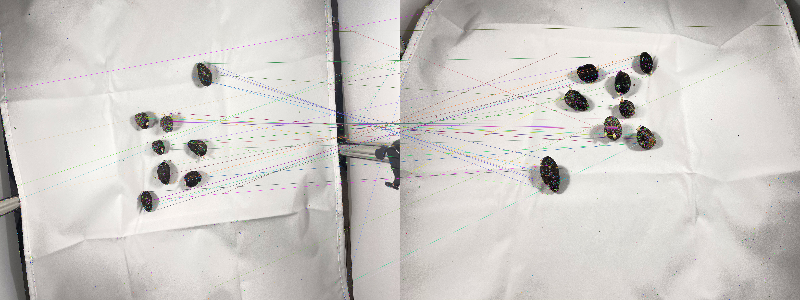

Total number of matches points: 
56
Coordinates of each matches points in Image 1: 
[(47.08846664428711, 1511.021484375), (54.601348876953125, 682.492919921875), (75.29996490478516, 1108.1820068359375), (169.87301635742188, 1406.2415771484375), (185.47793579101562, 1508.569091796875), (1391.0255126953125, 1564.6396484375), (1395.434326171875, 885.0608520507812), (1405.7103271484375, 891.9928588867188), (1436.3734130859375, 910.0192260742188), (1447.7674560546875, 1580.546630859375), (1483.4388427734375, 1523.177001953125), (1483.4388427734375, 1523.177001953125), (1505.1309814453125, 1513.109619140625), (1507.9227294921875, 1448.088623046875), (1511.4385986328125, 852.6848754882812), (1542.2174072265625, 1595.3572998046875), (1571.2532958984375, 1338.838134765625), (1601.7430419921875, 1101.623779296875), (1638.795166015625, 923.04736328125), (1638.795166015625, 923.04736328125), (1641.6124267578125, 922.5394897460938), (1641.9239501953125, 1132.414794921875), (1644.215087890625, 916.3

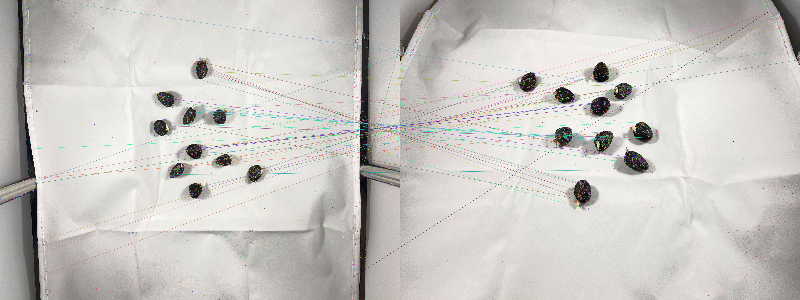

Total number of matches points: 
58
Coordinates of each matches points in Image 1: 
[(281.97296142578125, 1356.5469970703125), (317.40887451171875, 1124.6416015625), (354.9127502441406, 1347.35888671875), (355.79473876953125, 1373.182373046875), (361.32586669921875, 1387.9888916015625), (383.366455078125, 1916.263671875), (443.3397216796875, 1809.3753662109375), (467.1435546875, 2073.467041015625), (583.6129760742188, 7.029211521148682), (1641.40478515625, 739.4434204101562), (1671.1748046875, 1059.0380859375), (1710.0030517578125, 1320.1715087890625), (1745.7470703125, 953.6178588867188), (1783.9600830078125, 1182.8411865234375), (1797.9371337890625, 1259.10546875), (1798.5311279296875, 1267.539306640625), (1798.5311279296875, 1267.539306640625), (1831.956298828125, 775.3704223632812), (1852.9852294921875, 940.1036376953125), (1856.593994140625, 941.4966430664062), (1874.3848876953125, 1131.07470703125), (1901.73583984375, 1130.0985107421875), (1910.9903564453125, 844.68505859375), (1

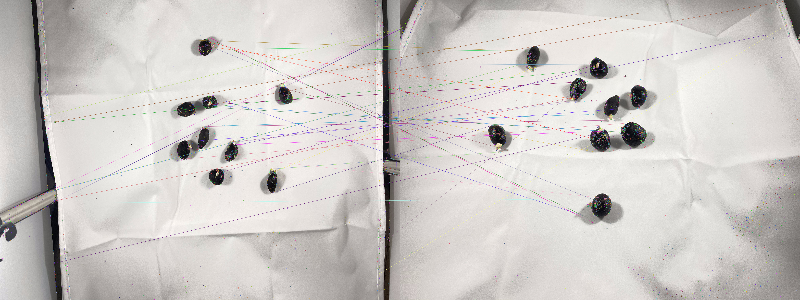

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(168.96849060058594, 1559.1556396484375), (320.9261779785156, 1618.7188720703125), (340.3293762207031, 1610.710205078125), (464.6779479980469, 1457.3912353515625), (465.47296142578125, 873.8956298828125), (485.0283203125, 1450.886474609375), (529.7239990234375, 1535.95751953125), (546.4181518554688, 1990.4288330078125), (550.5349731445312, 923.9855346679688), (552.1339721679688, 1518.2008056640625), (558.5877685546875, 921.8338623046875), (1849.0755615234375, 1201.1904296875), (1920.7811279296875, 801.38134765625), (1984.8038330078125, 1064.82958984375), (2001.29541015625, 304.7652282714844), (2072.464599609375, 337.7235412597656), (2089.708984375, 793.2726440429688), (2096.58740234375, 792.5806274414062), (2096.681884765625, 955.7644653320312), (2097.13623046875, 792.3668823242188), (2106.49951171875, 317.92138671875), (2111.105712890625, 793.8202514648438), (2117.05517578125, 285.4742126464844), (214

In [ ]:
# Image correspondence between top view and front view of good seeds
i = 1
while i < 11 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("front_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    if(img2.shape[0]>4000):
        img2 = cv2.rotate(img2,cv2.ROTATE_90_CLOCKWISE)
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "front_S" + str(i) + " view of good seeds")
    extract_sift(img1,img2)
    i += 1

In [ ]:
# replace this with your local directory
%cd '/content/drive/My Drive/COMP3029/2021-2022/Multiview_jpg/Bad seeds'
!ls

/content/drive/My Drive/COMP3029/2021-2022/Multiview_jpg/Bad seeds
front_S10.jpg  left_S11.jpg  rear_S12.jpg   right_S1.jpg  top_S1.jpg
front_S11.jpg  left_S12.jpg  rear_S1.jpg    right_S2.jpg  top_S2.jpg
front_S12.jpg  left_S1.jpg   rear_S2.jpg    right_S3.jpg  top_S3.jpg
front_S1.jpg   left_S2.jpg   rear_S3.jpg    right_S4.jpg  top_S4.jpg
front_S2.jpg   left_S3.jpg   rear_S4.jpg    right_S5.jpg  top_S5.jpg
front_S3.jpg   left_S4.jpg   rear_S5.jpg    right_S6.jpg  top_S6.jpg
front_S4.jpg   left_S5.jpg   rear_S6.jpg    right_S7.jpg  top_S7.jpg
front_S5.jpg   left_S6.jpg   rear_S7.jpg    right_S8.jpg  top_S8.jpg
front_S6.jpg   left_S7.jpg   rear_S8.jpg    right_S9.jpg  top_S9.jpg
front_S7.jpg   left_S8.jpg   rear_S9.jpg    Set1
front_S8.jpg   left_S9.jpg   right_S10.jpg  top_S10.jpg
front_S9.jpg   rear_S10.jpg  right_S11.jpg  top_S11.jpg
left_S10.jpg   rear_S11.jpg  right_S12.jpg  top_S12.jpg


___________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and left_S1 view


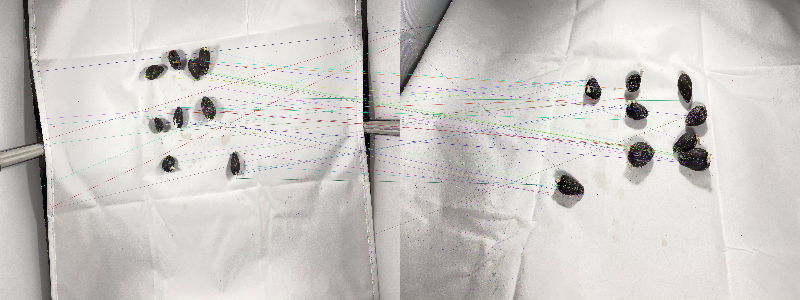

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(171.18653869628906, 1121.0703125), (243.5626220703125, 1111.7421875), (329.5794982910156, 545.3265380859375), (405.38690185546875, 899.3870239257812), (415.01409912109375, 946.85205078125), (420.1586608886719, 1410.416015625), (441.0545654296875, 1594.529541015625), (478.99151611328125, 1584.920654296875), (1412.70654296875, 574.3634643554688), (1508.3564453125, 914.4520874023438), (1528.4891357421875, 879.3460693359375), (1558.1502685546875, 999.5257568359375), (1602.01416015625, 946.2369995117188), (1679.0721435546875, 857.5436401367188), (1697.7822265625, 1237.7122802734375), (1697.7822265625, 1237.7122802734375), (1728.122314453125, 1067.9146728515625), (1734.7952880859375, 469.80206298828125), (1741.4044189453125, 1180.6650390625), (1765.8787841796875, 451.4148864746094), (1786.498779296875, 821.0235595703125), (1826.52392578125, 811.0746459960938), (1895.070556640625, 921.5774536132812), (1930.1

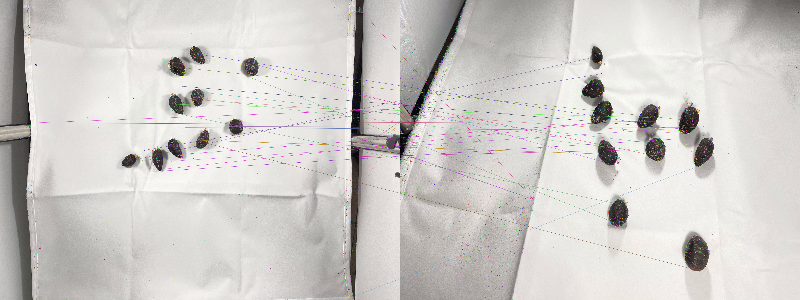

Total number of matches points: 
36
Coordinates of each matches points in Image 1: 
[(111.1916275024414, 937.8613891601562), (259.564697265625, 930.8780517578125), (1312.3984375, 1215.7462158203125), (1454.08935546875, 1135.5032958984375), (1625.64990234375, 1280.211181640625), (1638.3096923828125, 1292.11181640625), (1728.643798828125, 1218.220703125), (1777.90625, 787.7846069335938), (1785.3111572265625, 507.3841247558594), (1801.2103271484375, 1176.7978515625), (1831.0162353515625, 1165.98583984375), (1836.2763671875, 865.9276733398438), (1840.6868896484375, 652.0216674804688), (1872.97314453125, 963.643310546875), (1908.912353515625, 427.6903076171875), (1916.3668212890625, 749.8275756835938), (1979.9815673828125, 692.827880859375), (1989.8321533203125, 1064.005126953125), (2005.1890869140625, 410.0312194824219), (2033.030029296875, 747.8792724609375), (2044.69091796875, 1061.0947265625), (2044.69091796875, 1061.0947265625), (2320.028076171875, 955.7597045898438), (2543.32104492187

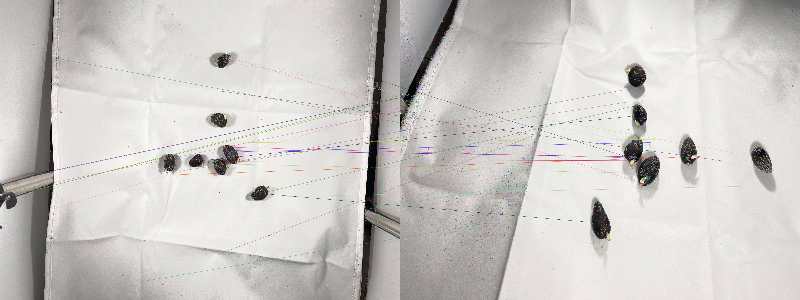

Total number of matches points: 
32
Coordinates of each matches points in Image 1: 
[(48.677085876464844, 1455.8704833984375), (286.5746765136719, 1449.7843017578125), (380.99871826171875, 1430.063720703125), (394.47137451171875, 1426.887451171875), (399.1396789550781, 1313.557861328125), (406.4427490234375, 1311.9290771484375), (456.800537109375, 1300.9984130859375), (543.8643188476562, 1577.5025634765625), (583.1839599609375, 441.38885498046875), (594.69873046875, 240.60218811035156), (1389.769775390625, 2133.0517578125), (1683.4403076171875, 1323.2572021484375), (1849.5103759765625, 1288.997314453125), (1849.5103759765625, 1288.997314453125), (1982.791748046875, 1217.2669677734375), (2141.325439453125, 1150.810546875), (2142.136474609375, 1079.8067626953125), (2177.37646484375, 1929.35498046875), (2228.5009765625, 689.0213012695312), (2235.0791015625, 416.6331481933594), (2278.20361328125, 1136.824462890625), (2305.308349609375, 1219.4678955078125), (2312.59814453125, 439.0560302734

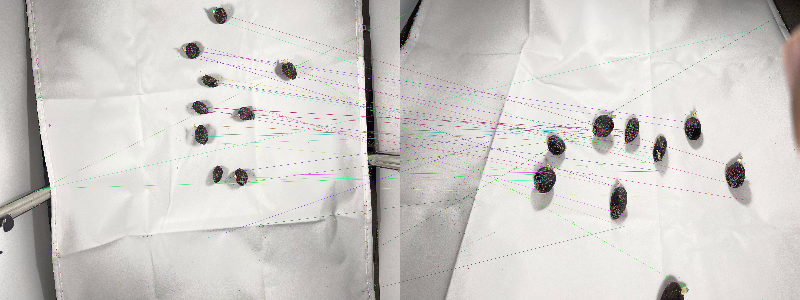

Total number of matches points: 
43
Coordinates of each matches points in Image 1: 
[(56.75605773925781, 1555.1947021484375), (362.4644775390625, 1441.1812744140625), (440.0684509277344, 1425.343017578125), (1872.865478515625, 389.4601135253906), (1891.1689453125, 815.3665771484375), (1891.1689453125, 815.3665771484375), (1899.0419921875, 328.41094970703125), (1938.9927978515625, 380.60528564453125), (1942.4114990234375, 381.5958557128906), (1942.4114990234375, 381.5958557128906), (1950.4993896484375, 438.8319091796875), (2014.25537109375, 813.2394409179688), (2029.4476318359375, 1021.2120361328125), (2048.836669921875, 1032.621826171875), (2055.6708984375, 1090.2861328125), (2058.885009765625, 810.1452026367188), (2078.86328125, 847.9319458007812), (2098.605224609375, 1380.8988037109375), (2099.45556640625, 949.843994140625), (2110.3896484375, 615.4051513671875), (2117.553955078125, 581.069580078125), (2156.41552734375, 634.1595458984375), (2182.822998046875, 626.6695556640625), (2183

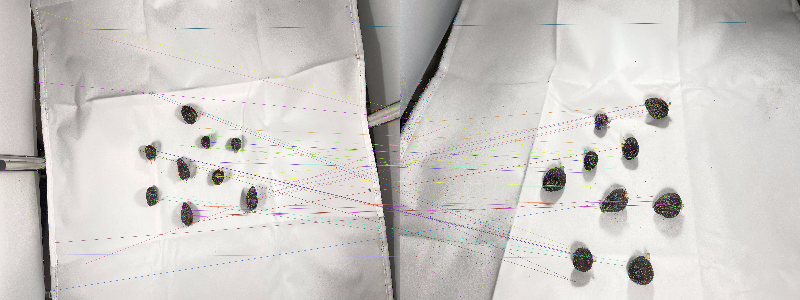

Total number of matches points: 
46
Coordinates of each matches points in Image 1: 
[(340.4237365722656, 147.61422729492188), (358.9374694824219, 74.81070709228516), (388.9111328125, 620.8145751953125), (459.122314453125, 2206.131591796875), (481.03863525390625, 227.5942840576172), (500.86700439453125, 1921.1927490234375), (562.5811767578125, 1833.855712890625), (868.1876220703125, 1991.4327392578125), (1413.8670654296875, 1137.8038330078125), (1494.1981201171875, 1126.6280517578125), (1494.1981201171875, 1126.6280517578125), (1497.769775390625, 1127.6771240234375), (1497.769775390625, 1127.6771240234375), (1507.9254150390625, 1493.5257568359375), (1519.647216796875, 1467.33349609375), (1524.2099609375, 711.6796264648438), (1527.3895263671875, 1179.544189453125), (1534.3873291015625, 1413.8702392578125), (1536.558349609375, 699.07958984375), (1743.3404541015625, 1093.7509765625), (1806.3956298828125, 1291.6357421875), (1850.9163818359375, 1629.9906005859375), (1850.9163818359375, 1629.

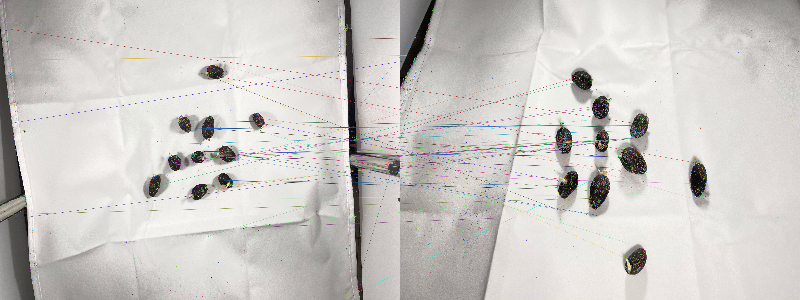

Total number of matches points: 
64
Coordinates of each matches points in Image 1: 
[(25.25846290588379, 1665.1396484375), (42.04435348510742, 452.9677734375), (70.8050537109375, 217.31500244140625), (122.14529418945312, 1620.549560546875), (123.1894302368164, 929.6971435546875), (1556.5740966796875, 1408.996337890625), (1556.5740966796875, 1408.996337890625), (1763.928466796875, 1229.0343017578125), (1763.928466796875, 1229.0343017578125), (1789.2103271484375, 1244.4140625), (1789.2103271484375, 1244.4140625), (1852.9888916015625, 911.077880859375), (1888.361328125, 974.3786010742188), (1892.4822998046875, 972.5806274414062), (1894.6307373046875, 1086.1810302734375), (1916.0533447265625, 1169.835693359375), (1993.734375, 1189.4635009765625), (1995.938720703125, 1183.8402099609375), (2006.44091796875, 1450.3602294921875), (2018.090087890625, 1174.2786865234375), (2018.2882080078125, 1508.0767822265625), (2032.5252685546875, 1201.4932861328125), (2033.9163818359375, 553.98974609375), (2

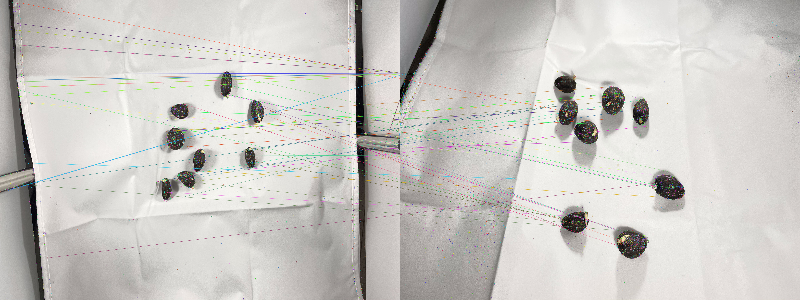

Total number of matches points: 
67
Coordinates of each matches points in Image 1: 
[(87.54886627197266, 1439.1783447265625), (137.83847045898438, 1427.072509765625), (145.5821533203125, 1424.844970703125), (160.93423461914062, 175.2541046142578), (161.75303649902344, 552.2862548828125), (164.6829071044922, 226.9180145263672), (166.70118713378906, 591.9124145507812), (168.63504028320312, 605.5670776367188), (172.13336181640625, 339.3788146972656), (176.15623474121094, 657.8671264648438), (176.59115600585938, 660.3512573242188), (176.61874389648438, 336.3704528808594), (185.9142608642578, 680.1439208984375), (186.47555541992188, 729.373291015625), (186.9538116455078, 729.574462890625), (190.79403686523438, 18.92696189880371), (208.40513610839844, 617.58837890625), (215.14427185058594, 1407.05859375), (219.12896728515625, 1406.16259765625), (219.43846130371094, 1394.10888671875), (265.5272216796875, 1391.6085205078125), (286.8134460449219, 1232.6456298828125), (317.76177978515625, 780.01

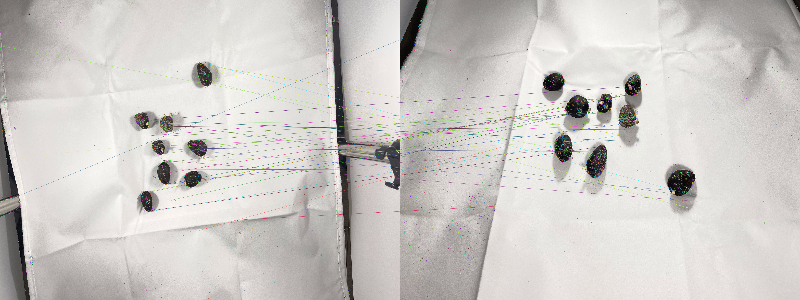

Total number of matches points: 
41
Coordinates of each matches points in Image 1: 
[(15.868228912353516, 347.800537109375), (66.12442016601562, 1195.949951171875), (127.88589477539062, 1498.1771240234375), (1436.3734130859375, 910.0192260742188), (1436.3734130859375, 910.0192260742188), (1491.8541259765625, 915.61767578125), (1491.8541259765625, 915.61767578125), (1498.6021728515625, 1447.9151611328125), (1501.6954345703125, 1453.040771484375), (1501.8992919921875, 1026.3060302734375), (1515.220947265625, 1593.0462646484375), (1542.2174072265625, 1595.3572998046875), (1599.3848876953125, 1279.2652587890625), (1634.0831298828125, 1117.9139404296875), (1649.4925537109375, 1028.8897705078125), (1660.1610107421875, 1310.0548095703125), (1660.1610107421875, 1310.0548095703125), (1662.241455078125, 1160.8873291015625), (1670.2562255859375, 1228.9559326171875), (1688.8115234375, 933.7356567382812), (1692.4339599609375, 1393.8194580078125), (1703.990234375, 1116.4111328125), (1711.58959960937

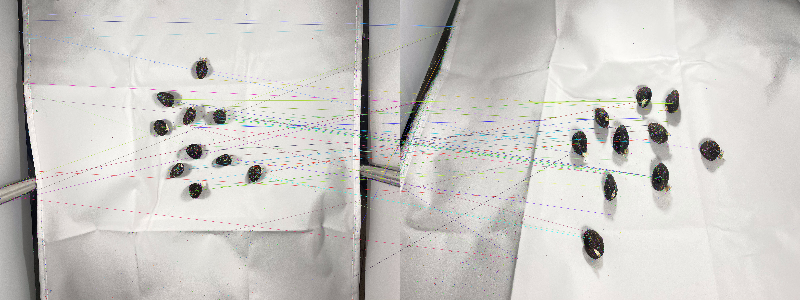

Total number of matches points: 
65
Coordinates of each matches points in Image 1: 
[(17.641071319580078, 1414.7879638671875), (24.101160049438477, 1535.078125), (68.82112121582031, 1403.631591796875), (188.15994262695312, 1493.9964599609375), (196.4139404296875, 240.24224853515625), (228.57252502441406, 627.1019897460938), (230.00234985351562, 680.0421752929688), (233.2435302734375, 1479.1119384765625), (244.45770263671875, 102.54428100585938), (247.32980346679688, 151.813720703125), (250.1774444580078, 737.7817993164062), (252.1585235595703, 292.1622009277344), (304.6132507324219, 1291.343505859375), (1587.531494140625, 750.6607055664062), (1612.66650390625, 764.1034545898438), (1617.596435546875, 964.9411010742188), (1646.2716064453125, 801.0144653320312), (1646.2716064453125, 801.0144653320312), (1686.6251220703125, 750.4743041992188), (1713.8917236328125, 756.5370483398438), (1762.275390625, 967.8952026367188), (1782.2142333984375, 1292.861572265625), (1795.977294921875, 789.52502

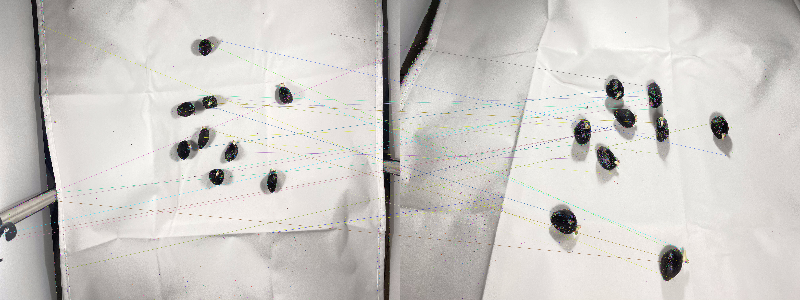

Total number of matches points: 
31
Coordinates of each matches points in Image 1: 
[(25.273468017578125, 1770.0963134765625), (91.42076110839844, 1820.8924560546875), (99.46489715576172, 1583.8729248046875), (154.36380004882812, 1784.413818359375), (424.42138671875, 196.58404541015625), (456.5340270996094, 1463.470703125), (538.614013671875, 1507.319091796875), (552.1339721679688, 1518.2008056640625), (684.1060180664062, 2030.5120849609375), (1848.8004150390625, 1135.505615234375), (1873.297607421875, 825.8419189453125), (1873.297607421875, 825.8419189453125), (1964.3416748046875, 719.4176025390625), (2017.8045654296875, 302.2781066894531), (2058.87451171875, 1039.5262451171875), (2062.5849609375, 968.8588256835938), (2096.533203125, 799.1641235351562), (2098.357177734375, 777.316162109375), (2101.784912109375, 731.9859008789062), (2178.682373046875, 1288.610595703125), (2225.6259765625, 310.1640625), (2257.675048828125, 761.0345458984375), (2257.675048828125, 761.0345458984375), (233

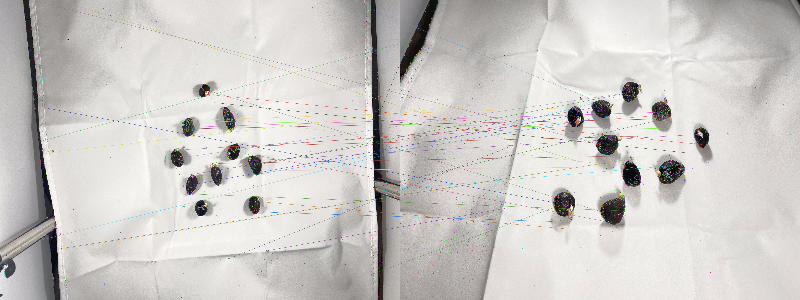

Total number of matches points: 
41
Coordinates of each matches points in Image 1: 
[(351.3245849609375, 6.517585754394531), (361.8797607421875, 1824.097900390625), (389.5301513671875, 1071.7613525390625), (446.5175476074219, 813.474365234375), (531.51025390625, 1150.7940673828125), (617.859375, 1878.261962890625), (618.393310546875, 1884.3741455078125), (814.033447265625, 51.915653228759766), (814.033447265625, 51.915653228759766), (1788.12841796875, 1197.1484375), (1811.77001953125, 1133.326416015625), (1900.5926513671875, 961.3261108398438), (1918.51953125, 1466.007080078125), (1923.478759765625, 1319.9461669921875), (1931.3603515625, 1397.7744140625), (1931.3603515625, 1397.7744140625), (1932.8077392578125, 908.8272094726562), (1951.736083984375, 973.0281372070312), (2008.4698486328125, 707.0481567382812), (2080.63232421875, 1112.214111328125), (2102.15234375, 685.21630859375), (2161.468017578125, 775.3377075195312), (2161.468017578125, 775.3377075195312), (2192.36669921875, 917.04

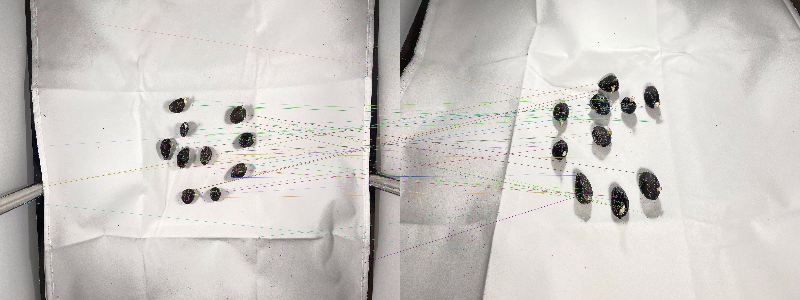

Total number of matches points: 
44
Coordinates of each matches points in Image 1: 
[(257.0466613769531, 1527.510986328125), (307.20208740234375, 101.54011535644531), (376.6187744140625, 1393.4124755859375), (380.52581787109375, 1106.2109375), (421.9447326660156, 1412.8922119140625), (1645.4429931640625, 1184.4937744140625), (1672.1068115234375, 1067.9263916015625), (1790.982666015625, 1248.966796875), (1791.14892578125, 1091.9705810546875), (1836.731201171875, 1126.7208251953125), (1846.731201171875, 1456.673583984375), (1846.731201171875, 1456.673583984375), (1854.2645263671875, 986.0140991210938), (1888.55224609375, 1265.192138671875), (1901.3546142578125, 1497.36181640625), (1904.9091796875, 1023.3989868164062), (1916.68115234375, 1017.8489379882812), (1939.32373046875, 793.5420532226562), (1943.08935546875, 758.4209594726562), (1994.9727783203125, 1154.7706298828125), (2078.008544921875, 1227.5494384765625), (2125.5859375, 1174.3414306640625), (2143.800048828125, 1448.869995117187

In [ ]:
# Image correspondence between top view and left view of bad seeds
i = 1
while i < 13 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("left_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("___________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "left_S" + str(i) + " view of bad seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and right_S1 view


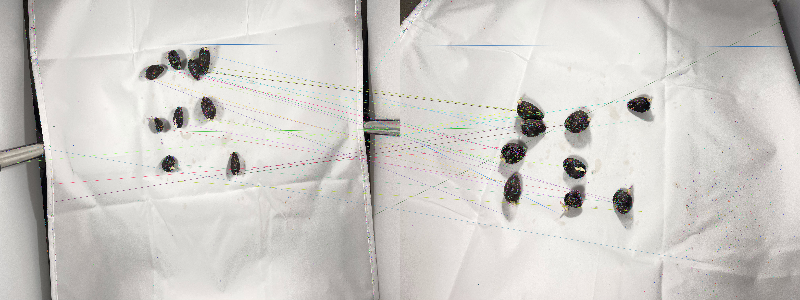

Total number of matches points: 
38
Coordinates of each matches points in Image 1: 
[(173.78514099121094, 1228.6011962890625), (265.7328186035156, 1099.5382080078125), (297.1084289550781, 330.0328674316406), (523.83203125, 1528.35498046875), (534.6588134765625, 1391.5546875), (1412.70654296875, 574.3634643554688), (1550.481689453125, 598.519775390625), (1565.6119384765625, 895.9402465820312), (1603.3385009765625, 997.816650390625), (1604.881103515625, 968.4033813476562), (1637.028564453125, 525.4798583984375), (1688.1861572265625, 1364.980712890625), (1697.7822265625, 1237.7122802734375), (1698.0096435546875, 484.58148193359375), (1717.59521484375, 547.1738891601562), (1765.8787841796875, 451.4148864746094), (1807.2607421875, 545.9099731445312), (1809.4686279296875, 886.0380859375), (1814.9027099609375, 519.437744140625), (1904.62548828125, 378.8253479003906), (2037.307373046875, 496.2062683105469), (2049.082275390625, 359.51995849609375), (2064.31884765625, 543.596923828125), (2065.37

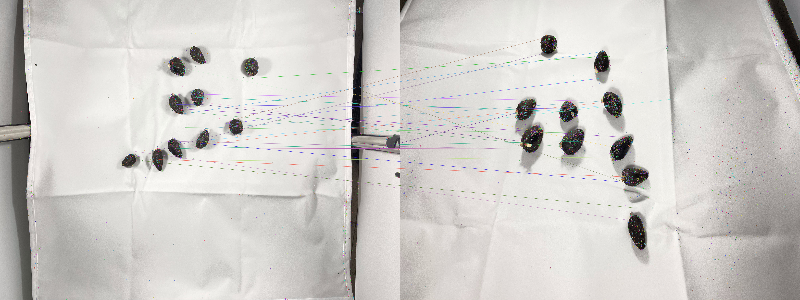

Total number of matches points: 
32
Coordinates of each matches points in Image 1: 
[(1364.8798828125, 1144.60009765625), (1435.6317138671875, 1215.9793701171875), (1540.9876708984375, 1143.5814208984375), (1597.4327392578125, 1205.112548828125), (1709.627197265625, 1066.7816162109375), (1728.643798828125, 1218.220703125), (1735.54833984375, 708.9058227539062), (1767.4566650390625, 1119.421142578125), (1767.4566650390625, 1119.421142578125), (1773.6964111328125, 789.2096557617188), (1773.929931640625, 1123.126220703125), (1785.3111572265625, 507.3841247558594), (1786.385498046875, 839.08642578125), (1831.122802734375, 861.6559448242188), (1846.1376953125, 823.400634765625), (1872.97314453125, 963.643310546875), (1938.789794921875, 764.1404418945312), (1954.079345703125, 782.293212890625), (1992.7047119140625, 735.7877197265625), (1992.7047119140625, 735.7877197265625), (2018.642822265625, 1090.9820556640625), (2022.860595703125, 1082.3389892578125), (2044.69091796875, 1061.0947265625),

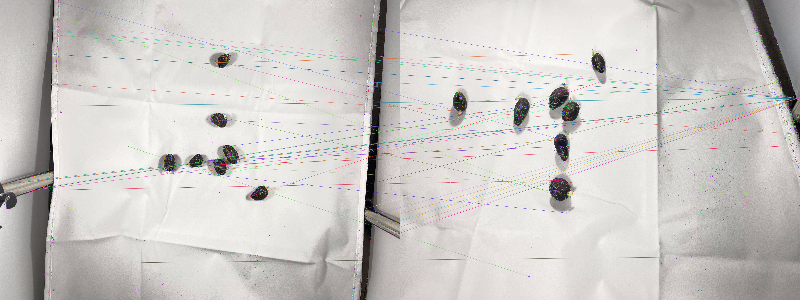

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(37.658836364746094, 1395.381591796875), (61.388519287109375, 1390.57763671875), (125.45970153808594, 1377.3480224609375), (317.8697204589844, 1439.3878173828125), (380.99871826171875, 1430.063720703125), (387.951171875, 1431.8731689453125), (394.47137451171875, 1426.887451171875), (397.6108703613281, 1429.6451416015625), (436.4102783203125, 1416.8729248046875), (511.0086669921875, 801.1273803710938), (527.4117431640625, 233.33624267578125), (551.743896484375, 263.59747314453125), (552.3341064453125, 411.759521484375), (554.370849609375, 227.91293334960938), (555.6507568359375, 633.3167114257812), (556.2754516601562, 179.2738037109375), (589.1170654296875, 14.61093521118164), (601.9340209960938, 118.9446792602539), (1291.4329833984375, 1107.083251953125), (1421.6544189453125, 1984.863037109375), (1592.299560546875, 1276.578857421875), (1620.30419921875, 1292.5679931640625), (1909.900390625, 1247.033325

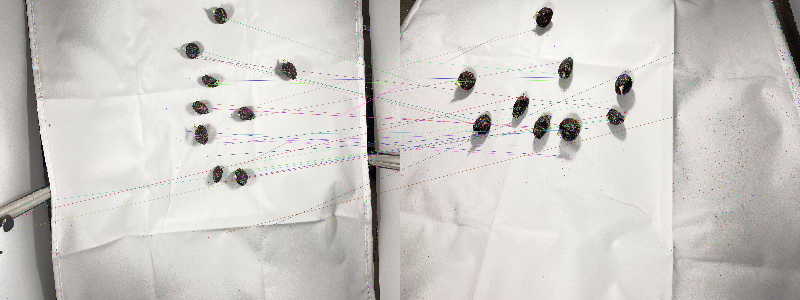

Total number of matches points: 
32
Coordinates of each matches points in Image 1: 
[(62.3486213684082, 1753.963134765625), (128.32028198242188, 1645.759765625), (250.46075439453125, 1543.765869140625), (1884.0789794921875, 1034.46826171875), (1884.5399169921875, 992.2301635742188), (1891.1689453125, 815.3665771484375), (1903.0869140625, 362.32623291015625), (1910.107666015625, 412.56011962890625), (1929.9794921875, 407.96441650390625), (1936.524169921875, 1023.4227905273438), (1959.94287109375, 775.3856201171875), (1968.9478759765625, 440.0785217285156), (1999.5179443359375, 414.72894287109375), (2014.25537109375, 813.2394409179688), (2029.4476318359375, 1021.2120361328125), (2031.404296875, 640.1581420898438), (2047.0655517578125, 612.4121704101562), (2061.723388671875, 1082.4598388671875), (2094.595703125, 1181.5767822265625), (2103.981689453125, 96.35101318359375), (2192.972412109375, 1316.5281982421875), (2192.972412109375, 1316.5281982421875), (2225.220458984375, 1330.72009277343

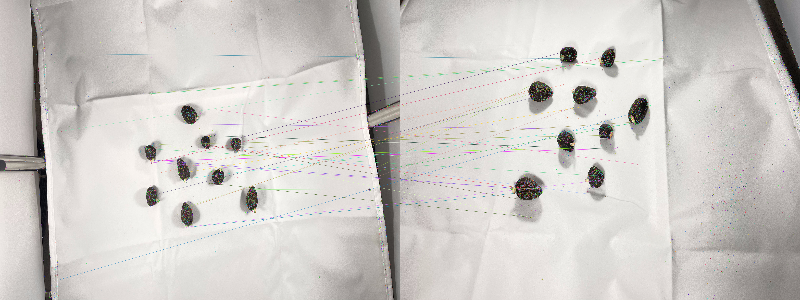

Total number of matches points: 
36
Coordinates of each matches points in Image 1: 
[(386.7334289550781, 405.0422058105469), (429.0755920410156, 1011.6923828125), (578.4566650390625, 2118.686767578125), (1499.412109375, 1124.583984375), (1508.4058837890625, 703.583740234375), (1517.8848876953125, 707.824951171875), (1527.0006103515625, 1232.4945068359375), (1529.5733642578125, 1226.0819091796875), (1556.618408203125, 1210.2850341796875), (1559.8603515625, 1471.9892578125), (1560.44921875, 1215.6878662109375), (1610.8369140625, 1091.886962890625), (1610.8369140625, 1091.886962890625), (1624.7591552734375, 1303.797607421875), (1874.16845703125, 1567.1312255859375), (1879.4287109375, 1716.299560546875), (1895.448486328125, 1717.62646484375), (1896.9974365234375, 1570.88134765625), (1904.0042724609375, 1348.761962890625), (1914.4073486328125, 936.848388671875), (1921.0975341796875, 1297.4150390625), (2066.38671875, 1096.2376708984375), (2109.187255859375, 1384.475830078125), (2115.88232421

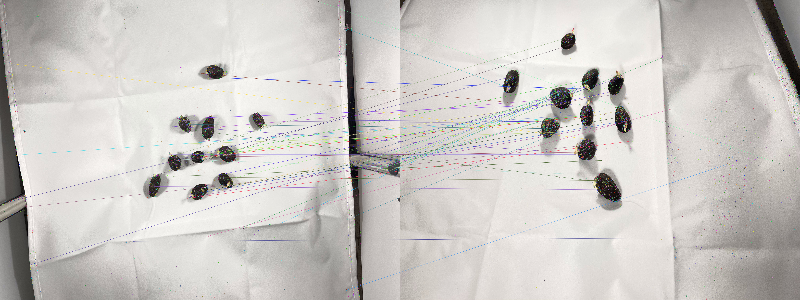

Total number of matches points: 
63
Coordinates of each matches points in Image 1: 
[(82.80986785888672, 1527.1217041015625), (110.26388549804688, 480.2299499511719), (162.66490173339844, 1172.2020263671875), (266.858154296875, 1564.4222412109375), (301.37493896484375, 2003.35595703125), (1347.080322265625, 1824.25048828125), (1556.5740966796875, 1408.996337890625), (1565.4200439453125, 1336.0360107421875), (1590.4854736328125, 1320.2357177734375), (1635.9405517578125, 1198.0277099609375), (1635.9405517578125, 1198.0277099609375), (1703.60888671875, 1166.5655517578125), (1734.713134765625, 954.004638671875), (1734.713134765625, 954.004638671875), (1745.75927734375, 1176.052734375), (1746.91845703125, 1332.7225341796875), (1827.6556396484375, 1216.9151611328125), (1846.18603515625, 910.5482788085938), (1863.9339599609375, 939.2401123046875), (1874.985107421875, 976.677734375), (1893.183837890625, 1499.078125), (1893.183837890625, 1499.078125), (1894.6307373046875, 1086.1810302734375), (

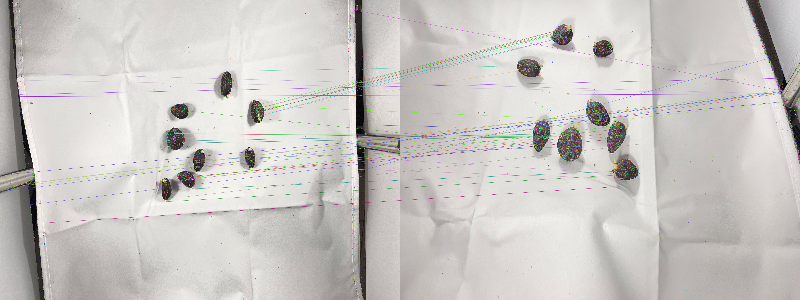

Total number of matches points: 
50
Coordinates of each matches points in Image 1: 
[(2.668698787689209, 1449.6141357421875), (115.8168716430664, 213.60064697265625), (116.50761413574219, 1315.2789306640625), (144.66802978515625, 1409.683349609375), (161.75303649902344, 552.2862548828125), (168.63504028320312, 605.5670776367188), (186.9538116455078, 729.574462890625), (196.81256103515625, 713.623291015625), (219.43846130371094, 1394.10888671875), (233.0391082763672, 1390.0111083984375), (305.4044189453125, 1546.982177734375), (424.5219421386719, 1686.3154296875), (1674.3768310546875, 1524.2423095703125), (1681.6365966796875, 1435.401611328125), (1731.777587890625, 826.1239013671875), (1758.88623046875, 1008.837646484375), (1766.4691162109375, 1009.4080200195312), (1769.5037841796875, 1082.4005126953125), (1769.5037841796875, 1082.4005126953125), (1772.2559814453125, 1008.6448974609375), (1780.3272705078125, 1065.786376953125), (1810.9566650390625, 1212.39111328125), (1835.7100830078125

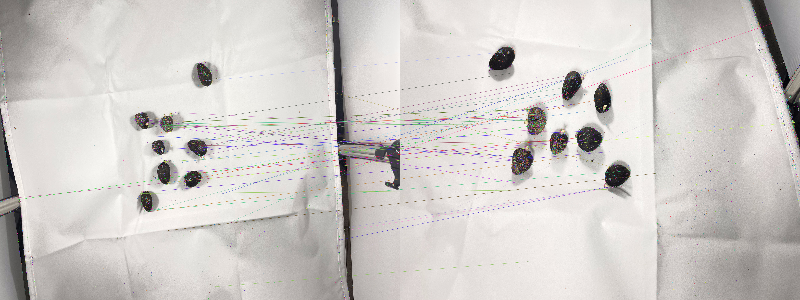

Total number of matches points: 
49
Coordinates of each matches points in Image 1: 
[(127.88589477539062, 1498.1771240234375), (185.47793579101562, 1508.569091796875), (1320.874755859375, 904.9495849609375), (1387.51318359375, 976.9629516601562), (1391.6431884765625, 891.87646484375), (1398.15380859375, 900.4517822265625), (1402.7401123046875, 880.3255615234375), (1414.6051025390625, 1462.2923583984375), (1419.6649169921875, 925.1080322265625), (1501.8992919921875, 1026.3060302734375), (1515.220947265625, 1593.0462646484375), (1542.2174072265625, 1595.3572998046875), (1555.438232421875, 1586.050048828125), (1566.325439453125, 1104.55419921875), (1613.3839111328125, 1442.0677490234375), (1634.3272705078125, 948.0460205078125), (1646.0635986328125, 1221.6785888671875), (1654.0579833984375, 964.4136352539062), (1657.0863037109375, 1128.0484619140625), (1657.4097900390625, 936.197021484375), (1660.1610107421875, 1310.0548095703125), (1665.3724365234375, 1392.8294677734375), (1670.132568359

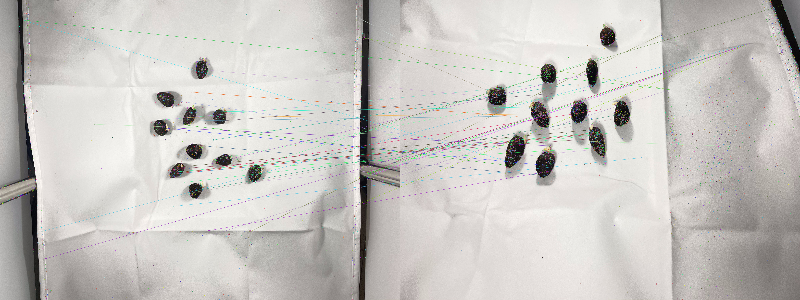

Total number of matches points: 
52
Coordinates of each matches points in Image 1: 
[(259.0412292480469, 152.42044067382812), (290.0411682128906, 166.0604248046875), (422.09442138671875, 1749.3275146484375), (455.95904541015625, 1956.0394287109375), (955.1465454101562, 939.407470703125), (1617.596435546875, 964.9411010742188), (1643.740478515625, 905.828857421875), (1657.5548095703125, 905.9691162109375), (1686.6251220703125, 750.4743041992188), (1747.34814453125, 1559.3516845703125), (1761.537109375, 1277.5909423828125), (1762.275390625, 967.8952026367188), (1787.702880859375, 1313.036865234375), (1791.5755615234375, 1310.9119873046875), (1792.0830078125, 1302.8408203125), (1794.9383544921875, 1298.0960693359375), (1822.282470703125, 1260.2620849609375), (1854.9443359375, 1378.5216064453125), (1863.5869140625, 944.2799682617188), (1885.1259765625, 913.53662109375), (1888.3973388671875, 887.322509765625), (1913.8094482421875, 877.1156005859375), (1926.3565673828125, 1458.6270751953125)

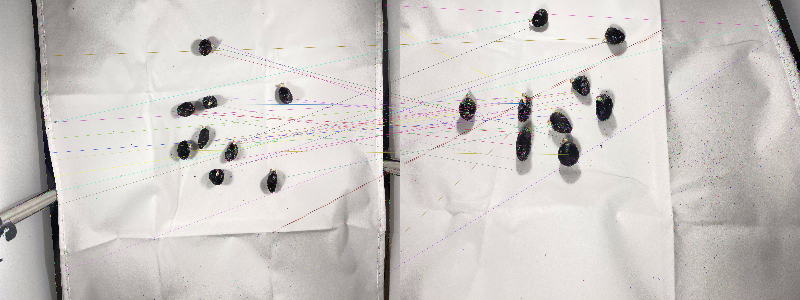

Total number of matches points: 
38
Coordinates of each matches points in Image 1: 
[(319.4449462890625, 1608.4110107421875), (426.5523376464844, 1474.2169189453125), (464.4359130859375, 422.1254577636719), (479.4855651855469, 1050.87255859375), (503.58740234375, 1155.3826904296875), (514.4067993164062, 1212.6458740234375), (546.2896728515625, 1334.8426513671875), (550.5349731445312, 923.9855346679688), (555.8922729492188, 2074.562744140625), (558.5877685546875, 921.8338623046875), (1736.308837890625, 840.2515258789062), (1848.8004150390625, 1135.505615234375), (1852.1221923828125, 1088.511962890625), (1873.297607421875, 825.8419189453125), (1873.297607421875, 825.8419189453125), (1947.6480712890625, 860.0505981445312), (2019.966796875, 373.44580078125), (2030.8499755859375, 1101.4580078125), (2096.58740234375, 792.5806274414062), (2101.784912109375, 731.9859008789062), (2150.222900390625, 353.8247375488281), (2191.69189453125, 1310.3565673828125), (2192.98876953125, 795.8319702148438)

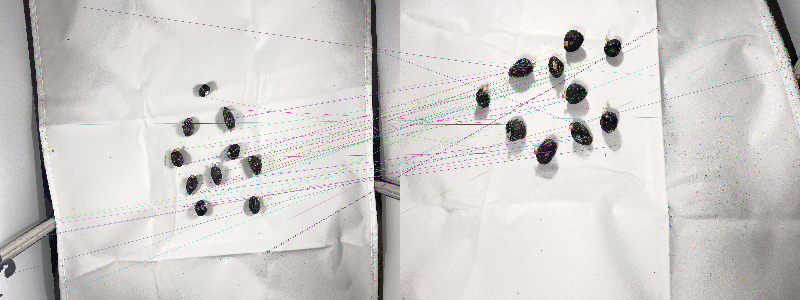

Total number of matches points: 
54
Coordinates of each matches points in Image 1: 
[(47.43376159667969, 2081.47509765625), (138.78050231933594, 1819.4425048828125), (376.1358947753906, 1709.545166015625), (452.7965393066406, 1677.129638671875), (453.8225402832031, 944.96728515625), (467.9950866699219, 1780.63720703125), (511.86334228515625, 1658.8099365234375), (637.1830444335938, 2207.941162109375), (659.2583618164062, 2128.842041015625), (814.033447265625, 51.915653228759766), (814.033447265625, 51.915653228759766), (1788.12841796875, 1197.1484375), (1835.0093994140625, 1244.7506103515625), (1835.0093994140625, 1244.7506103515625), (1847.8721923828125, 1562.7242431640625), (1859.201171875, 1564.069580078125), (1867.8397216796875, 1125.345458984375), (1898.0860595703125, 933.0741577148438), (1930.4173583984375, 1340.3870849609375), (1931.3603515625, 1397.7744140625), (1940.61572265625, 1466.689453125), (1949.7315673828125, 1463.804931640625), (2026.1029052734375, 1577.2962646484375),

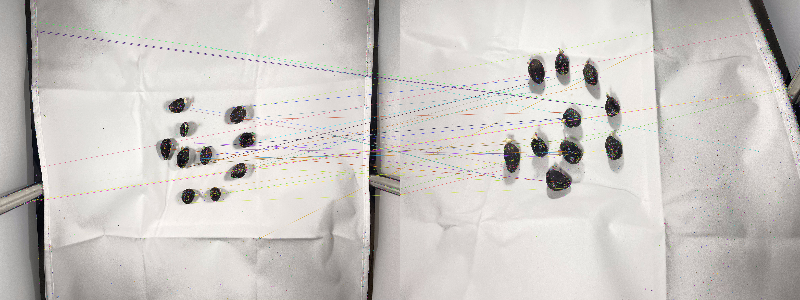

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(140.42837524414062, 1452.82421875), (275.9173583984375, 1530.8775634765625), (305.8313293457031, 1520.3731689453125), (325.0707702636719, 1513.7640380859375), (373.9226989746094, 166.0862579345703), (377.08160400390625, 231.25689697265625), (377.5235595703125, 241.3017120361328), (408.33319091796875, 1263.488525390625), (1671.013427734375, 1124.05078125), (1671.013427734375, 1124.05078125), (1717.0615234375, 808.0670166015625), (1780.1773681640625, 1245.9974365234375), (1789.9832763671875, 800.9937133789062), (1824.0146484375, 1270.219970703125), (1835.384033203125, 1078.8558349609375), (1847.3941650390625, 1201.117431640625), (1855.4932861328125, 1533.67724609375), (1888.55224609375, 1265.192138671875), (1892.9383544921875, 1263.2520751953125), (1898.853759765625, 1484.5126953125), (1947.5994873046875, 1439.6370849609375), (1991.829345703125, 339.49310302734375), (2037.0289306640625, 1489.23986816406

In [ ]:
# Image correspondence between top view and right view of bad seeds
i = 1
while i < 13 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("right_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "right_S" + str(i) + " view of bad seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and rear_S1 view


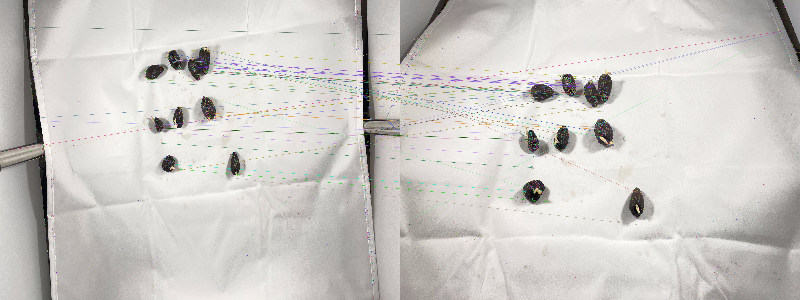

Total number of matches points: 
52
Coordinates of each matches points in Image 1: 
[(125.4253921508789, 1131.6927490234375), (295.2787780761719, 1214.632080078125), (327.53704833984375, 204.5720672607422), (403.50634765625, 889.3888549804688), (408.4085693359375, 915.0407104492188), (1483.0455322265625, 620.993896484375), (1485.4127197265625, 599.322021484375), (1602.01416015625, 946.2369995117188), (1602.59716796875, 977.00146484375), (1604.881103515625, 968.4033813476562), (1604.881103515625, 968.4033813476562), (1635.6453857421875, 1083.6318359375), (1679.421630859375, 511.0992126464844), (1679.947021484375, 397.8500671386719), (1697.7822265625, 1237.7122802734375), (1702.6788330078125, 1003.7410888671875), (1730.4647216796875, 1295.4490966796875), (1765.8787841796875, 451.4148864746094), (1765.8787841796875, 451.4148864746094), (1777.030517578125, 455.53765869140625), (1804.4718017578125, 1279.57958984375), (1806.2305908203125, 552.657470703125), (1904.62548828125, 378.82534790039

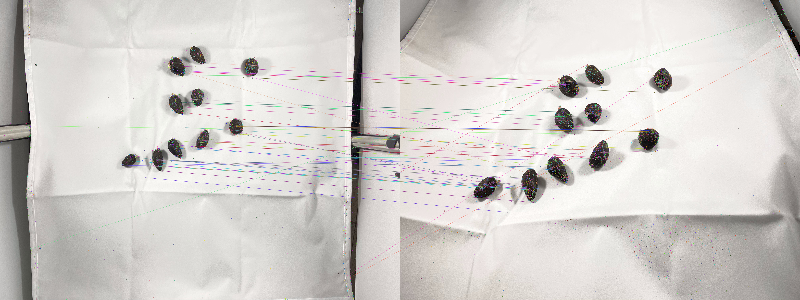

Total number of matches points: 
52
Coordinates of each matches points in Image 1: 
[(285.13922119140625, 951.1869506835938), (306.5289611816406, 1881.5372314453125), (1238.492431640625, 1252.3101806640625), (1312.3984375, 1215.7462158203125), (1314.6058349609375, 1264.9229736328125), (1394.09130859375, 1193.2772216796875), (1468.143310546875, 1342.356689453125), (1571.851318359375, 1209.9744873046875), (1578.067626953125, 1205.1361083984375), (1594.7701416015625, 1256.8963623046875), (1594.7701416015625, 1256.8963623046875), (1597.4327392578125, 1205.112548828125), (1599.2098388671875, 1252.4273681640625), (1599.2098388671875, 1252.4273681640625), (1599.2098388671875, 1252.4273681640625), (1599.5064697265625, 1256.0391845703125), (1599.5064697265625, 1256.0391845703125), (1638.3096923828125, 1292.11181640625), (1651.963134765625, 1207.806640625), (1695.5361328125, 1088.31005859375), (1707.432861328125, 496.9158630371094), (1728.643798828125, 1218.220703125), (1758.845947265625, 843.39

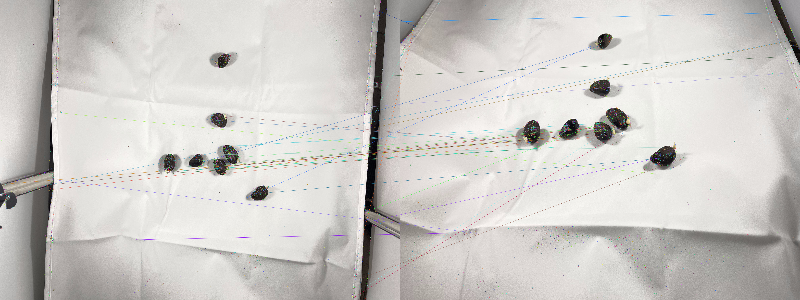

Total number of matches points: 
35
Coordinates of each matches points in Image 1: 
[(37.654991149902344, 1392.216064453125), (452.3620910644531, 1403.153564453125), (477.06634521484375, 1399.1036376953125), (532.2277221679688, 1357.281494140625), (533.4165649414062, 1431.914306640625), (607.882080078125, 852.9169311523438), (1378.6263427734375, 1811.9654541015625), (1592.299560546875, 1276.578857421875), (1746.431884765625, 1308.6236572265625), (1849.5103759765625, 1288.997314453125), (1982.791748046875, 1217.2669677734375), (2037.29052734375, 1171.2103271484375), (2058.233642578125, 1220.7357177734375), (2087.403564453125, 904.3551025390625), (2196.14990234375, 1256.7432861328125), (2210.1396484375, 1287.916015625), (2215.58203125, 1262.7835693359375), (2233.4970703125, 1106.4962158203125), (2240.497802734375, 1313.1527099609375), (2255.399169921875, 874.8606567382812), (2310.70263671875, 1106.9908447265625), (2492.178955078125, 1492.991943359375), (2621.669677734375, 1461.8544921875

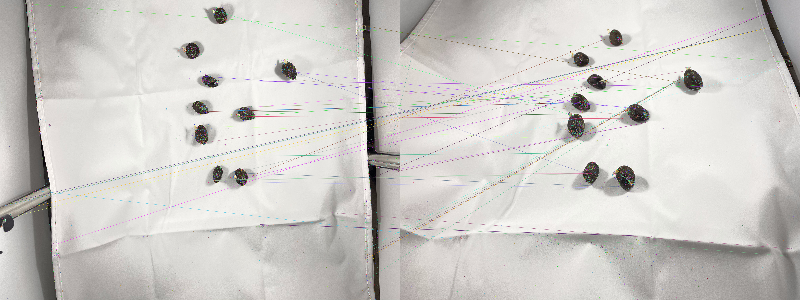

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(56.75605773925781, 1555.1947021484375), (91.31848907470703, 1543.584716796875), (162.70016479492188, 1633.3575439453125), (168.40440368652344, 1517.4893798828125), (259.1474609375, 27.048782348632812), (362.4644775390625, 1441.1812744140625), (389.0679931640625, 1554.367919921875), (523.4022827148438, 1855.52490234375), (2040.563720703125, 608.7081909179688), (2046.777099609375, 1079.6278076171875), (2051.92529296875, 844.1535034179688), (2065.310546875, 841.2135620117188), (2073.44384765625, 577.3507690429688), (2093.132568359375, 836.3406982421875), (2094.595703125, 1181.5767822265625), (2099.45556640625, 949.843994140625), (2152.234619140625, 1349.1683349609375), (2170.480712890625, 1364.39208984375), (2173.134765625, 1360.5302734375), (2174.875, 82.98157501220703), (2192.972412109375, 1316.5281982421875), (2270.91455078125, 1372.948974609375), (2358.73046875, 878.7888793945312), (2367.426513671875

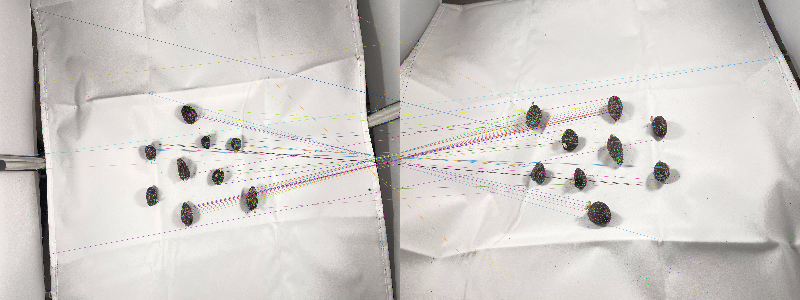

Total number of matches points: 
70
Coordinates of each matches points in Image 1: 
[(249.79714965820312, 1172.3206787109375), (315.8220520019531, 1174.150390625), (317.8252258300781, 66.93574523925781), (367.2593688964844, 1278.0325927734375), (388.9111328125, 620.8145751953125), (500.86700439453125, 1921.1927490234375), (1506.96044921875, 1127.367431640625), (1510.18603515625, 1126.8251953125), (1518.607421875, 1134.65478515625), (1524.2099609375, 711.6796264648438), (1544.987060546875, 1082.8077392578125), (1545.2071533203125, 1205.781982421875), (1575.7215576171875, 1116.5797119140625), (1610.8369140625, 1091.886962890625), (1743.3404541015625, 1093.7509765625), (1834.468994140625, 814.3643798828125), (1850.367919921875, 845.0247802734375), (1861.29541015625, 1586.833984375), (1864.103759765625, 829.4229736328125), (1869.5230712890625, 1598.4993896484375), (1874.16845703125, 1567.1312255859375), (1874.16845703125, 1567.1312255859375), (1874.5045166015625, 1578.7801513671875), (1877

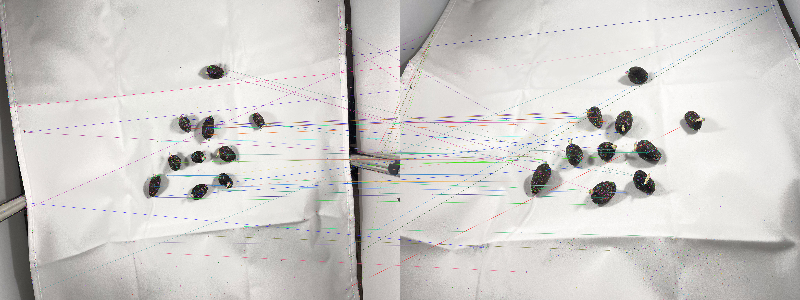

Total number of matches points: 
63
Coordinates of each matches points in Image 1: 
[(101.05992889404297, 812.5805053710938), (186.46104431152344, 1606.009033203125), (247.6876983642578, 998.6304931640625), (252.39703369140625, 998.9488525390625), (255.87896728515625, 1532.1839599609375), (407.30963134765625, 2187.59619140625), (1308.27880859375, 1828.7850341796875), (1483.9354248046875, 1494.608154296875), (1556.5740966796875, 1408.996337890625), (1563.5909423828125, 1485.76318359375), (1580.8203125, 1325.9620361328125), (1623.7437744140625, 1070.5760498046875), (1632.136474609375, 1913.1102294921875), (1686.375, 1375.8082275390625), (1686.375, 1375.8082275390625), (1690.9300537109375, 1327.1370849609375), (1763.928466796875, 1229.0343017578125), (1856.510498046875, 955.1509399414062), (1857.5079345703125, 950.05029296875), (1861.0816650390625, 955.4324340820312), (1874.249267578125, 969.5248413085938), (1886.46044921875, 977.1297607421875), (1889.6014404296875, 899.4901733398438), (1

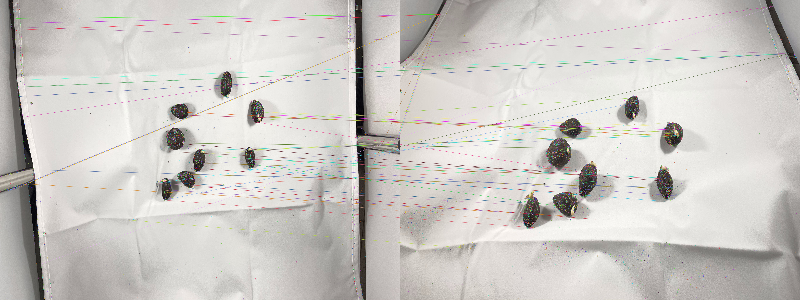

Total number of matches points: 
62
Coordinates of each matches points in Image 1: 
[(87.54886627197266, 1439.1783447265625), (104.7568588256836, 1435.326904296875), (118.07469940185547, 201.7633056640625), (137.83847045898438, 1427.072509765625), (145.5821533203125, 1424.844970703125), (160.93423461914062, 175.2541046142578), (161.2043914794922, 138.8270263671875), (164.6829071044922, 226.9180145263672), (168.63504028320312, 605.5670776367188), (176.15623474121094, 657.8671264648438), (176.59115600585938, 660.3512573242188), (186.47555541992188, 729.373291015625), (186.9538116455078, 729.574462890625), (215.14427185058594, 1407.05859375), (219.12896728515625, 1406.16259765625), (230.04481506347656, 885.50341796875), (237.9960174560547, 1388.876953125), (302.32879638671875, 1282.2318115234375), (414.3074951171875, 1994.9326171875), (1302.7506103515625, 1663.3516845703125), (1587.00927734375, 1374.369140625), (1592.3311767578125, 1385.5318603515625), (1616.1077880859375, 1380.6525878906

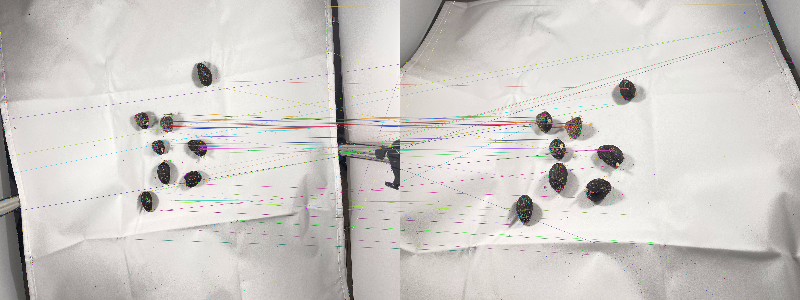

Total number of matches points: 
67
Coordinates of each matches points in Image 1: 
[(27.753408432006836, 906.8782958984375), (99.62650299072266, 1178.95556640625), (136.7961883544922, 1307.5284423828125), (139.04840087890625, 1599.174072265625), (1180.8182373046875, 1804.1470947265625), (1387.51318359375, 976.9629516601562), (1427.4901123046875, 858.1431274414062), (1443.099365234375, 921.2314453125), (1443.099365234375, 921.2314453125), (1443.4971923828125, 930.5470581054688), (1445.1495361328125, 909.8359375), (1447.9830322265625, 940.7249145507812), (1449.7589111328125, 916.8599243164062), (1449.7589111328125, 916.8599243164062), (1450.5772705078125, 1445.4906005859375), (1454.7305908203125, 909.912841796875), (1474.5819091796875, 869.2977294921875), (1483.4388427734375, 1523.177001953125), (1499.9090576171875, 1444.8961181640625), (1501.8992919921875, 1026.3060302734375), (1507.9227294921875, 1448.088623046875), (1508.2816162109375, 1512.763671875), (1508.2816162109375, 1512.76367

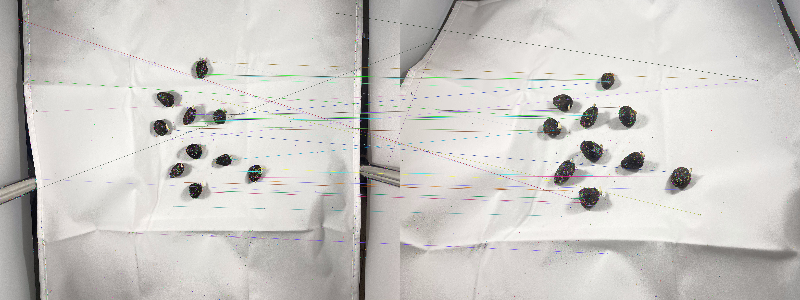

Total number of matches points: 
45
Coordinates of each matches points in Image 1: 
[(188.93894958496094, 145.51475524902344), (190.24652099609375, 163.95779418945312), (210.5143280029297, 1476.25341796875), (300.63165283203125, 606.3955078125), (307.04510498046875, 1350.636474609375), (379.9281005859375, 844.8753662109375), (1296.7259521484375, 1761.3131103515625), (1669.6025390625, 977.9910278320312), (1671.1748046875, 1059.0380859375), (1745.7470703125, 953.6178588867188), (1747.34814453125, 1559.3516845703125), (1762.275390625, 967.8952026367188), (1854.9443359375, 1378.5216064453125), (1891.6470947265625, 907.5648193359375), (1891.6470947265625, 907.5648193359375), (1892.43701171875, 900.8196411132812), (1892.43701171875, 900.8196411132812), (1899.8797607421875, 919.654296875), (1923.6282958984375, 866.0152587890625), (1941.8154296875, 846.943115234375), (1947.7930908203125, 872.7057495117188), (1969.1500244140625, 1441.7283935546875), (1980.424560546875, 592.6587524414062), (1997

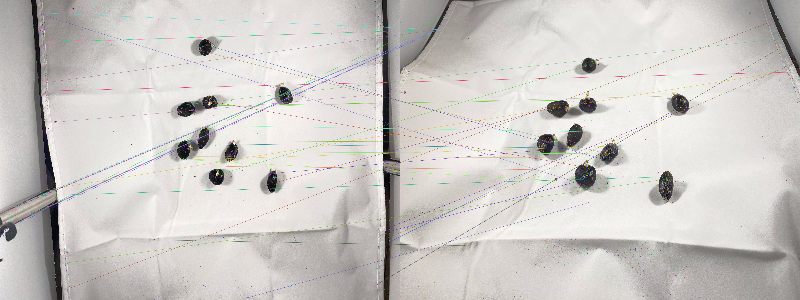

Total number of matches points: 
53
Coordinates of each matches points in Image 1: 
[(107.92191314697266, 1581.1011962890625), (112.50343322753906, 1579.45703125), (124.74227905273438, 1567.26513671875), (156.40577697753906, 1563.973876953125), (163.4803009033203, 1679.3560791015625), (178.1913604736328, 1556.5814208984375), (188.78277587890625, 1668.0919189453125), (193.4019317626953, 1551.0452880859375), (203.1279754638672, 1679.189453125), (210.9700927734375, 1535.6690673828125), (227.96783447265625, 1653.3328857421875), (320.9261779785156, 1618.7188720703125), (400.0362243652344, 96.87342834472656), (409.26708984375, 1477.8709716796875), (413.6084899902344, 322.8464660644531), (416.2786865234375, 319.521728515625), (419.5819091796875, 111.47249603271484), (432.16680908203125, 1582.8441162109375), (433.86993408203125, 627.266845703125), (449.2718505859375, 1575.7117919921875), (478.21612548828125, 1432.587158203125), (478.566650390625, 1563.6136474609375), (479.9408264160156, 687.35

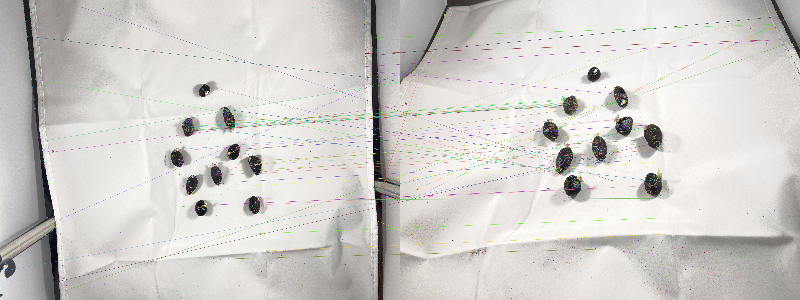

Total number of matches points: 
57
Coordinates of each matches points in Image 1: 
[(42.45548629760742, 2048.2333984375), (269.9674987792969, 272.858154296875), (319.95733642578125, 595.0804443359375), (414.60498046875, 1068.86279296875), (539.9030151367188, 1148.2679443359375), (557.1104736328125, 1671.6177978515625), (600.3822021484375, 2125.031005859375), (600.8738403320312, 2211.376953125), (814.033447265625, 51.915653228759766), (1779.4129638671875, 1140.374267578125), (1867.8397216796875, 1125.345458984375), (1883.223388671875, 984.9772338867188), (1893.1614990234375, 992.8718872070312), (1900.5926513671875, 961.3261108398438), (1905.47021484375, 954.932373046875), (1928.24658203125, 955.9987182617188), (1929.433349609375, 989.0029296875), (1932.9755859375, 984.1707153320312), (1936.04736328125, 974.612548828125), (2034.9393310546875, 638.8168334960938), (2050.00341796875, 1513.843017578125), (2060.3046875, 1514.341796875), (2164.600341796875, 1548.5670166015625), (2164.60034179

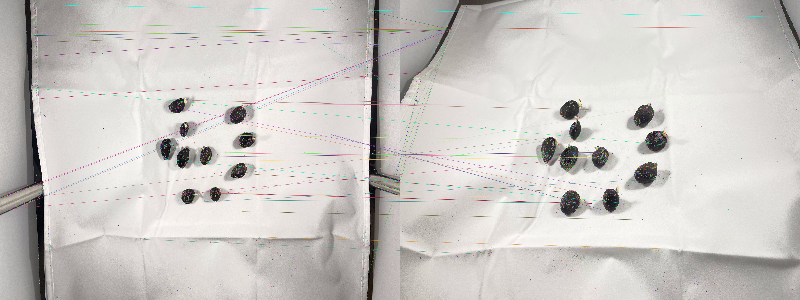

Total number of matches points: 
53
Coordinates of each matches points in Image 1: 
[(26.16739845275879, 1485.0247802734375), (28.513301849365234, 1493.5230712890625), (110.67732238769531, 1578.7889404296875), (191.8480224609375, 1564.2362060546875), (204.46182250976562, 1559.594482421875), (268.0760192871094, 263.7873229980469), (313.0502624511719, 664.3721313476562), (329.67742919921875, 178.65567016601562), (332.1571044921875, 749.0349731445312), (333.3288269042969, 268.651123046875), (335.55963134765625, 319.9474792480469), (336.4291076660156, 264.935302734375), (346.4139709472656, 424.81048583984375), (364.5749206542969, 36.57160949707031), (377.5235595703125, 241.3017120361328), (396.78179931640625, 1483.0079345703125), (440.61328125, 1479.5400390625), (1372.75048828125, 1806.7509765625), (1641.5225830078125, 1201.990966796875), (1765.6201171875, 815.3663330078125), (1795.80419921875, 793.984375), (1842.9083251953125, 1531.7257080078125), (1846.731201171875, 1456.673583984375), (

In [ ]:
# Image correspondence between top view and rear view of bad seeds
i = 1
while i < 13 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("rear_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "rear_S" + str(i) + " view of bad seeds")
    extract_sift(img1,img2)
    i += 1

____________________________________________________________________________________________________
Image correspondence of seeds between top_S1 view and front_S1 view


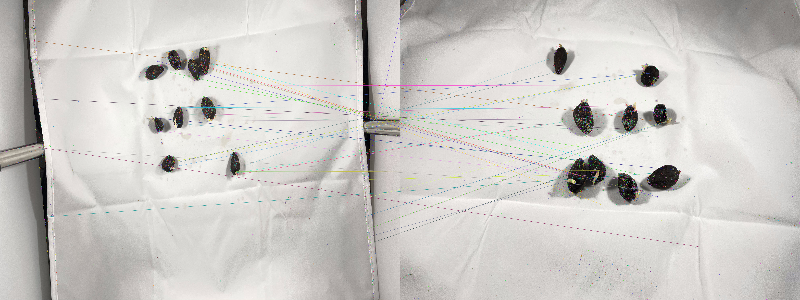

Total number of matches points: 
40
Coordinates of each matches points in Image 1: 
[(243.5626220703125, 1111.7421875), (265.7328186035156, 1099.5382080078125), (328.81524658203125, 742.8582153320312), (349.44464111328125, 642.1637573242188), (362.6903076171875, 310.4248352050781), (444.4156188964844, 1640.372802734375), (1560.3731689453125, 891.2216186523438), (1586.97314453125, 461.2259521484375), (1601.6290283203125, 992.2359619140625), (1679.0721435546875, 857.5436401367188), (1717.59521484375, 547.1738891601562), (1720.415283203125, 1224.7039794921875), (1725.6038818359375, 914.8068237304688), (1741.4044189453125, 1180.6650390625), (1765.8787841796875, 451.4148864746094), (1778.1871337890625, 931.1516723632812), (1807.2850341796875, 1253.356201171875), (1820.803466796875, 1221.162109375), (1825.8826904296875, 818.3348388671875), (1826.52392578125, 811.0746459960938), (1865.2847900390625, 462.31829833984375), (1904.62548828125, 378.8253479003906), (2022.3985595703125, 489.046417236

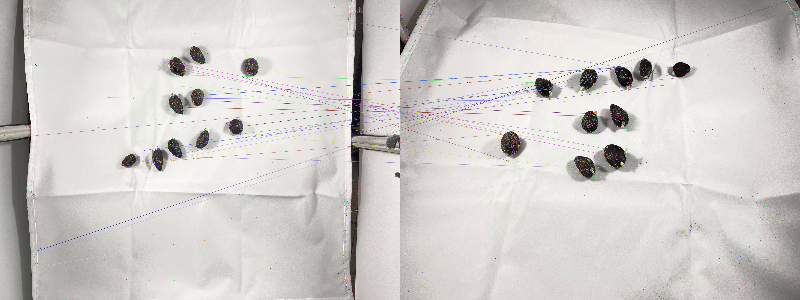

Total number of matches points: 
33
Coordinates of each matches points in Image 1: 
[(268.3626708984375, 1030.9173583984375), (312.0690002441406, 1945.590576171875), (347.33660888671875, 2025.3153076171875), (374.8494873046875, 1896.12060546875), (1093.9481201171875, 737.5797729492188), (1230.7950439453125, 1243.385986328125), (1238.492431640625, 1252.3101806640625), (1314.6058349609375, 1264.9229736328125), (1454.08935546875, 1135.5032958984375), (1552.92724609375, 1228.654052734375), (1710.746337890625, 513.7706909179688), (1713.9052734375, 468.8168640136719), (1766.044677734375, 1183.904296875), (1767.4566650390625, 1119.421142578125), (1770.1263427734375, 753.8101806640625), (1785.3111572265625, 507.3841247558594), (1809.61083984375, 566.7678833007812), (1840.6868896484375, 652.0216674804688), (1891.8084716796875, 811.9760131835938), (1969.0279541015625, 504.0483093261719), (2047.91943359375, 718.332763671875), (2047.91943359375, 718.332763671875), (2051.56640625, 719.5809326171875

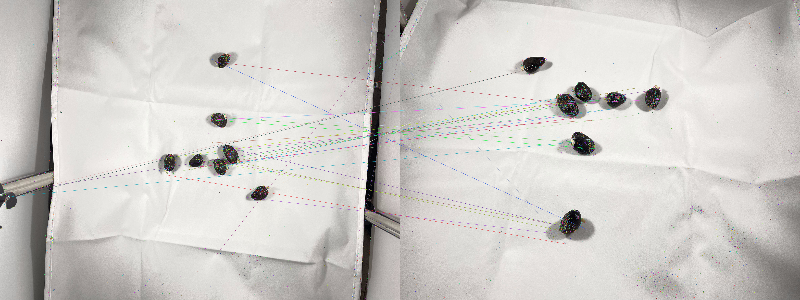

Total number of matches points: 
39
Coordinates of each matches points in Image 1: 
[(96.4463882446289, 1487.4591064453125), (242.13934326171875, 1469.304443359375), (379.5433044433594, 1423.2044677734375), (493.6485900878906, 1407.5694580078125), (616.1573486328125, 852.6619262695312), (1678.07275390625, 1195.3924560546875), (1683.4403076171875, 1323.2572021484375), (1849.5103759765625, 1288.997314453125), (1849.5103759765625, 1288.997314453125), (1981.1883544921875, 1202.4661865234375), (1998.5771484375, 1262.6695556640625), (2019.7646484375, 1260.2532958984375), (2037.29052734375, 1171.2103271484375), (2087.403564453125, 904.3551025390625), (2103.770751953125, 1225.4737548828125), (2139.569091796875, 451.0726318359375), (2139.569091796875, 451.0726318359375), (2140.86328125, 905.4638061523438), (2141.065673828125, 1208.5416259765625), (2142.136474609375, 1079.8067626953125), (2177.37646484375, 1929.35498046875), (2191.6474609375, 470.4622497558594), (2215.58203125, 1262.783569335937

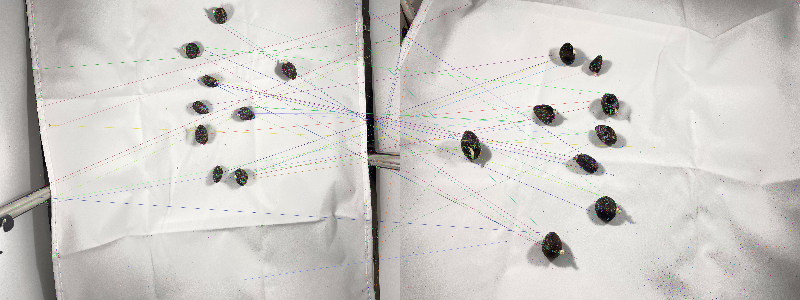

Total number of matches points: 
47
Coordinates of each matches points in Image 1: 
[(121.88142395019531, 1571.54736328125), (263.9604797363281, 1484.462890625), (329.42596435546875, 525.529296875), (369.306640625, 814.383544921875), (395.9070129394531, 995.1994018554688), (396.7769470214844, 1548.0509033203125), (412.666748046875, 1535.4595947265625), (440.0684509277344, 1425.343017578125), (450.5790100097656, 1401.2261962890625), (500.98883056640625, 946.932861328125), (1889.51953125, 341.3232116699219), (1891.1689453125, 815.3665771484375), (1912.2813720703125, 592.9766235351562), (1934.203125, 383.31707763671875), (2014.25537109375, 813.2394409179688), (2020.09765625, 1016.1778564453125), (2029.83837890625, 590.4544677734375), (2046.3092041015625, 373.5966796875), (2067.478271484375, 610.453857421875), (2070.56640625, 116.47313690185547), (2077.1337890625, 78.84770965576172), (2098.605224609375, 1380.8988037109375), (2110.3896484375, 615.4051513671875), (2117.553955078125, 581.0695

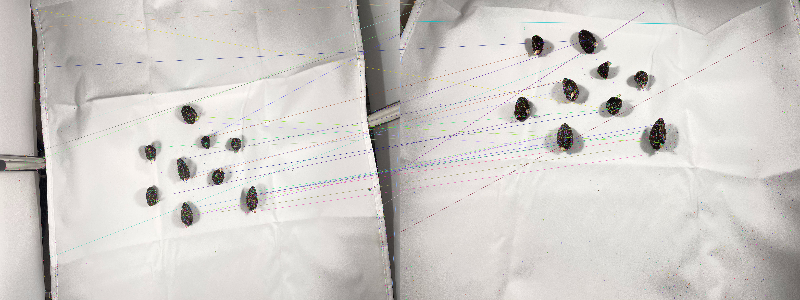

Total number of matches points: 
38
Coordinates of each matches points in Image 1: 
[(78.99227142333984, 1292.1229248046875), (95.5107192993164, 1216.0343017578125), (314.9690246582031, 67.31620025634766), (338.15301513671875, 131.86289978027344), (356.5010070800781, 207.96266174316406), (430.0791931152344, 1016.3822021484375), (457.37322998046875, 507.1477355957031), (505.5363464355469, 1944.7342529296875), (1575.7215576171875, 1116.5797119140625), (1757.5799560546875, 1462.913818359375), (1794.6258544921875, 1209.1600341796875), (1871.0343017578125, 1355.04541015625), (1877.3961181640625, 1630.719482421875), (1880.160400390625, 1324.607421875), (1889.0592041015625, 1580.26220703125), (1896.804443359375, 1638.618408203125), (1967.9930419921875, 917.5689086914062), (1980.0108642578125, 880.8026123046875), (2046.806640625, 1119.2685546875), (2103.726806640625, 1032.4791259765625), (2161.176025390625, 1027.134521484375), (2213.519775390625, 1317.1273193359375), (2215.750732421875, 1601.6

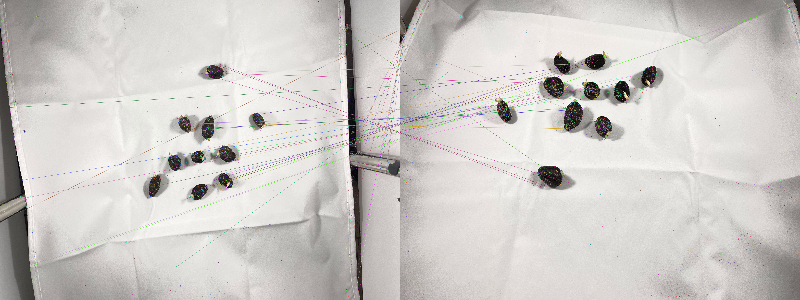

Total number of matches points: 
51
Coordinates of each matches points in Image 1: 
[(101.05992889404297, 812.5805053710938), (156.38230895996094, 1619.0987548828125), (223.7819061279297, 1361.843505859375), (245.20669555664062, 1497.98095703125), (301.37493896484375, 2003.35595703125), (347.2293701171875, 2003.6446533203125), (1556.5740966796875, 1408.996337890625), (1556.5740966796875, 1408.996337890625), (1779.2962646484375, 2016.904296875), (1779.2962646484375, 2016.904296875), (1848.1387939453125, 932.9564819335938), (1916.0533447265625, 1169.835693359375), (1916.8331298828125, 997.3955688476562), (1939.263671875, 1192.302001953125), (1976.4447021484375, 931.615234375), (1984.9493408203125, 1142.572021484375), (2033.9163818359375, 553.98974609375), (2063.33447265625, 1415.597412109375), (2063.33447265625, 1415.597412109375), (2081.630126953125, 968.4679565429688), (2090.66552734375, 1420.6854248046875), (2124.875244140625, 973.9427490234375), (2128.382080078125, 1202.6473388671875

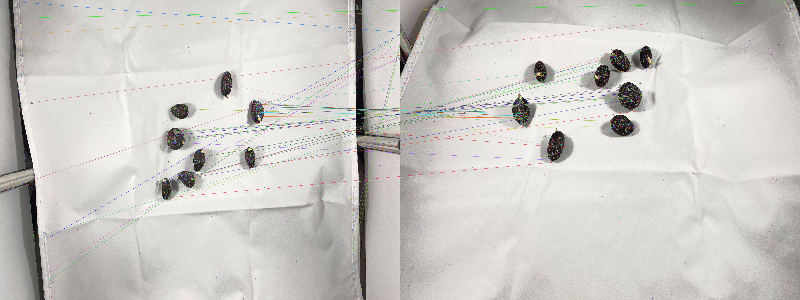

Total number of matches points: 
62
Coordinates of each matches points in Image 1: 
[(189.9086151123047, 260.6475524902344), (190.389892578125, 14.845049858093262), (200.18724060058594, 135.67247009277344), (319.757568359375, 774.0032348632812), (348.8809509277344, 1356.1728515625), (388.9687194824219, 1786.89990234375), (423.9040222167969, 2097.984130859375), (459.1379089355469, 1809.82080078125), (478.0865783691406, 1949.7666015625), (501.83056640625, 2111.77783203125), (503.9510498046875, 2122.672119140625), (1574.0068359375, 1380.443359375), (1637.5062255859375, 1384.975341796875), (1659.3277587890625, 1368.858642578125), (1678.8778076171875, 1379.2725830078125), (1681.288330078125, 1074.0906982421875), (1687.1766357421875, 1514.2142333984375), (1691.841064453125, 1507.733642578125), (1705.6788330078125, 1076.3907470703125), (1735.20068359375, 1491.473876953125), (1746.922607421875, 1052.314697265625), (1746.922607421875, 1052.314697265625), (1753.146728515625, 1055.83984375), (175

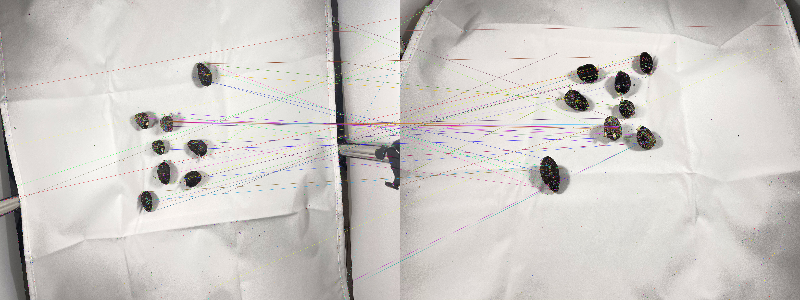

Total number of matches points: 
59
Coordinates of each matches points in Image 1: 
[(47.08846664428711, 1511.021484375), (54.601348876953125, 682.492919921875), (75.29996490478516, 1108.1820068359375), (169.87301635742188, 1406.2415771484375), (185.47793579101562, 1508.569091796875), (1391.0255126953125, 1564.6396484375), (1395.434326171875, 885.0608520507812), (1405.7103271484375, 891.9928588867188), (1436.3734130859375, 910.0192260742188), (1447.7674560546875, 1580.546630859375), (1483.4388427734375, 1523.177001953125), (1483.4388427734375, 1523.177001953125), (1505.1309814453125, 1513.109619140625), (1507.9227294921875, 1448.088623046875), (1511.4385986328125, 852.6848754882812), (1542.2174072265625, 1595.3572998046875), (1571.2532958984375, 1338.838134765625), (1601.7430419921875, 1101.623779296875), (1628.439697265625, 921.3394165039062), (1633.7532958984375, 929.6990966796875), (1638.795166015625, 923.04736328125), (1638.795166015625, 923.04736328125), (1641.6124267578125, 922.5

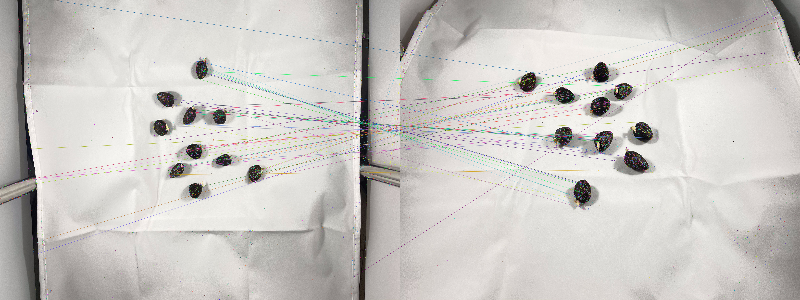

Total number of matches points: 
57
Coordinates of each matches points in Image 1: 
[(110.13338470458984, 1392.2843017578125), (281.97296142578125, 1356.5469970703125), (317.40887451171875, 1124.6416015625), (354.9127502441406, 1347.35888671875), (361.32586669921875, 1387.9888916015625), (383.366455078125, 1916.263671875), (443.3397216796875, 1809.3753662109375), (583.6129760742188, 7.029211521148682), (1641.40478515625, 739.4434204101562), (1671.1748046875, 1059.0380859375), (1710.0030517578125, 1320.1715087890625), (1745.7470703125, 953.6178588867188), (1783.9600830078125, 1182.8411865234375), (1797.9371337890625, 1259.10546875), (1798.5311279296875, 1267.539306640625), (1798.5311279296875, 1267.539306640625), (1831.956298828125, 775.3704223632812), (1852.9852294921875, 940.1036376953125), (1856.593994140625, 941.4966430664062), (1874.3848876953125, 1131.07470703125), (1901.73583984375, 1130.0985107421875), (1910.9903564453125, 844.68505859375), (1927.3887939453125, 859.5235595703125

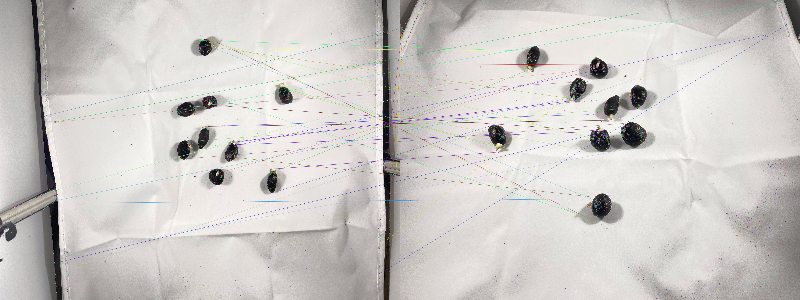

Total number of matches points: 
48
Coordinates of each matches points in Image 1: 
[(464.6779479980469, 1457.3912353515625), (465.47296142578125, 873.8956298828125), (485.0283203125, 1450.886474609375), (529.7239990234375, 1535.95751953125), (546.4181518554688, 1990.4288330078125), (550.5349731445312, 923.9855346679688), (552.1339721679688, 1518.2008056640625), (558.5877685546875, 921.8338623046875), (607.9657592773438, 1928.5877685546875), (666.92578125, 2043.58740234375), (1849.0755615234375, 1201.1904296875), (1920.7811279296875, 801.38134765625), (1984.8038330078125, 1064.82958984375), (2001.29541015625, 304.7652282714844), (2072.464599609375, 337.7235412597656), (2089.708984375, 793.2726440429688), (2096.58740234375, 792.5806274414062), (2096.681884765625, 955.7644653320312), (2097.13623046875, 792.3668823242188), (2106.49951171875, 317.92138671875), (2111.105712890625, 793.8202514648438), (2117.05517578125, 285.4742126464844), (2143.651611328125, 355.4998474121094), (2173.851806

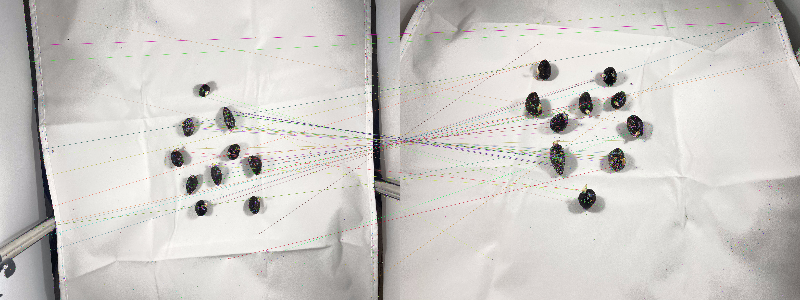

Total number of matches points: 
55
Coordinates of each matches points in Image 1: 
[(275.01092529296875, 1754.4571533203125), (283.2330017089844, 342.4991149902344), (300.5970153808594, 466.46710205078125), (360.080810546875, 1719.5418701171875), (362.5111083984375, 93.20925903320312), (364.9744567871094, 597.1024169921875), (398.542236328125, 1131.659912109375), (423.689453125, 1791.906494140625), (436.88177490234375, 1198.6214599609375), (469.928955078125, 1330.2474365234375), (509.9106140136719, 1894.20166015625), (531.8700561523438, 1559.6412353515625), (554.8211669921875, 1688.1490478515625), (1779.4129638671875, 1140.374267578125), (1788.12841796875, 1197.1484375), (1844.9267578125, 948.9320068359375), (1867.8397216796875, 1125.345458984375), (1872.7313232421875, 982.2755737304688), (1884.3114013671875, 970.2264404296875), (1898.0860595703125, 933.0741577148438), (1900.5926513671875, 961.3261108398438), (1902.0338134765625, 916.3833618164062), (1909.422119140625, 943.84100341796

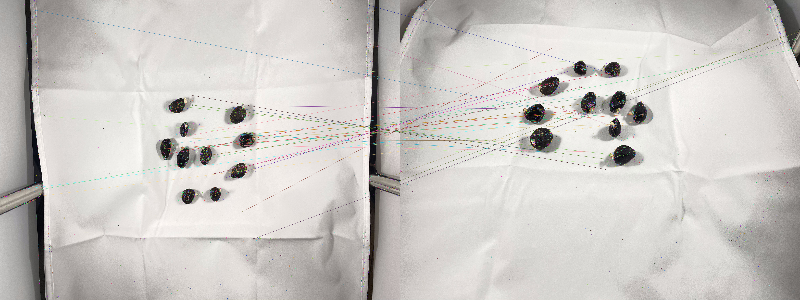

Total number of matches points: 
39
Coordinates of each matches points in Image 1: 
[(238.61598205566406, 1429.7261962890625), (356.4535827636719, 76.4673080444336), (396.78179931640625, 1483.0079345703125), (429.5791931152344, 1430.711181640625), (429.8321228027344, 1430.585693359375), (458.0531311035156, 877.2315063476562), (1671.013427734375, 1124.05078125), (1683.721435546875, 1165.64794921875), (1683.721435546875, 1165.64794921875), (1735.118408203125, 1085.444091796875), (1746.4234619140625, 1052.8497314453125), (1789.9832763671875, 800.9937133789062), (1872.8377685546875, 1123.62255859375), (1879.765869140625, 1028.0406494140625), (1888.3311767578125, 950.0257568359375), (1913.2197265625, 717.5552978515625), (1939.32373046875, 793.5420532226562), (1967.27978515625, 1118.2144775390625), (2053.940185546875, 1117.9541015625), (2077.17822265625, 1176.278076171875), (2164.99072265625, 1312.0626220703125), (2278.165771484375, 1341.59619140625), (2328.02587890625, 1274.0465087890625), 

In [ ]:
# Image correspondence between top view and front view of bad seeds
i = 1
while i < 13 :
    img1 = cv2.imread("top_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY)# queryImage
    if(img1.shape[0]>4000):
        img1 = cv2.rotate(img1,cv2.ROTATE_90_CLOCKWISE)
    img2 = cv2.imread("front_S" + str(i) + ".jpg", cv2.COLOR_BGR2GRAY) # trainImage
    if(img2.shape[0]>4000):
        img2 = cv2.rotate(img2,cv2.ROTATE_90_CLOCKWISE)
    print("____________________________________________________________________________________________________")
    print("Image correspondence of seeds between "+"top_S" + str(i) + " view and " + "front_S" + str(i) + " view of bad seeds")
    extract_sift(img1,img2)
    i += 1